In [1]:
# Basic import necessary for configuration.
import os
import warnings
import requests

warnings.simplefilter("ignore", RuntimeWarning)

maindir = os.path.join(os.getcwd(), '../Data/')

# Set CRDS cache directory to user home if not already set.
if os.getenv('CRDS_PATH') is None:
    os.environ['CRDS_PATH'] = os.path.join(os.path.expanduser('~'), 'crds_cache')

# Check whether the CRDS server URL has been set. If not, set it.
if os.getenv('CRDS_SERVER_URL') is None:
    os.environ['CRDS_SERVER_URL'] = 'https://jwst-crds.stsci.edu'

# Output the current CRDS path and server URL in use.
print('CRDS local filepath:', os.environ['CRDS_PATH'])
print('CRDS file server:', os.environ['CRDS_SERVER_URL'])

CRDS local filepath: /home/fran/crds_cache
CRDS file server: https://jwst-crds.stsci.edu


In [2]:
# ----------------------General Imports----------------------
import time
import glob
import json
import itertools
import numpy as np
import pandas as pd

# --------------------Astroquery Imports---------------------
from astroquery.mast import Observations

# ----------------------Astropy Imports----------------------
# Astropy utilities for opening FITS files, downloading demo files, etc.
from astropy.io import fits
from astropy.table import Table
from astropy.stats import sigma_clip
from astropy.visualization import ImageNormalize, ManualInterval, LogStretch
from astropy.visualization import LinearStretch, AsinhStretch, simple_norm

# ----------------------Plotting Imports---------------------
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from matplotlib.collections import PatchCollection

import scienceplots
plt.style.use('science')

# -------------------File Download Imports-------------------
from tqdm.auto import tqdm
from multiprocessing import Pool, cpu_count
from functools import partial

In [3]:
# ----------------------JWST Calibration Pipeline Imports----------------------
import jwst  # Import the base JWST and CRDS packages.
import crds
from crds.client import api
from stpipe import crds_client

# JWST pipelines (each encompassing many steps).
from jwst.pipeline import Detector1Pipeline  # calwebb_detector1
from jwst.pipeline import Spec2Pipeline  # calwebb_spec2
from jwst.pipeline import Tso3Pipeline  # calwebb_tso3
from jwst.extract_1d import Extract1dStep  # Extract1D Step

# JWST pipeline utilities
from jwst import datamodels  # JWST pipeline utilities: datamodels.
from jwst.associations import asn_from_list  # Tools for creating association files.
from jwst.associations.lib.rules_level2b import Asn_Lv2SpecTSO
from jwst.associations.lib.rules_level3 import DMS_Level3_Base

# Check the default context for the Pipeline version
default_context = crds.get_default_context('jwst', state='build')
print("JWST Calibration Pipeline Version = {}".format(jwst.__version__))
print(f"Default CRDS Context for JWST Version {jwst.__version__}: {default_context}")
print(f"Using CRDS Context: {os.environ.get('CRDS_CONTEXT', default_context)}")

CRDS - INFO -  Calibration SW Found: jwst 1.18.0 (/home/fran/.local/lib/python3.13/site-packages/jwst-1.18.0.dist-info)


JWST Calibration Pipeline Version = 1.18.0
Default CRDS Context for JWST Version 1.18.0: jwst_1364.pmap
Using CRDS Context: jwst_1364.pmap


In [4]:
sci_dir = os.path.join(maindir, f'data_01366/Obs003/')
uncal_dir = os.path.join(sci_dir, f'uncal/')
det1_dir = os.path.join(sci_dir, 'stage1/') 

os.makedirs(det1_dir, exist_ok=True)

In [5]:
# list files in uncal directory
rateints_files = glob.glob(det1_dir  + '*nrs2*' + '*ints*' )
print(f"Science UNCAL Files:\n{'-'*20}\n" + "\n".join(rateints_files))

Science UNCAL Files:
--------------------
/home/fran/OneDrive/BSc Project/Notebooks/../Data/data_01366/Obs003/stage1/jw01366003001_04101_00001-seg001_nrs2_rateints.fits
/home/fran/OneDrive/BSc Project/Notebooks/../Data/data_01366/Obs003/stage1/jw01366003001_04101_00001-seg002_nrs2_rateints.fits
/home/fran/OneDrive/BSc Project/Notebooks/../Data/data_01366/Obs003/stage1/jw01366003001_04101_00001-seg003_nrs2_rateints.fits


In [6]:
with fits.open(rateints_files[0]) as hdul:
    # Print the header information for the first HDU
    print(hdul.info())
    print(hdul[0].header)

Filename: /home/fran/OneDrive/BSc Project/Notebooks/../Data/data_01366/Obs003/stage1/jw01366003001_04101_00001-seg001_nrs2_rateints.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     252   ()      
  1  SCI           1 ImageHDU        63   (2048, 32, 155)   float32   
  2  ERR           1 ImageHDU        11   (2048, 32, 155)   float32   
  3  DQ            1 ImageHDU        12   (2048, 32, 155)   int32 (rescales to uint32)   
  4  INT_TIMES     1 BinTableHDU     24   155R x 7C   [J, D, D, D, D, D, D]   
  5  VAR_POISSON    1 ImageHDU        10   (2048, 32, 155)   float32   
  6  VAR_RNOISE    1 ImageHDU        10   (2048, 32, 155)   float32   
  7  ASDF          1 BinTableHDU     11   1R x 1C   [10987B]   
None
SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                    8 / array data type                                NAXIS   =                    0 / number of array dimensions        

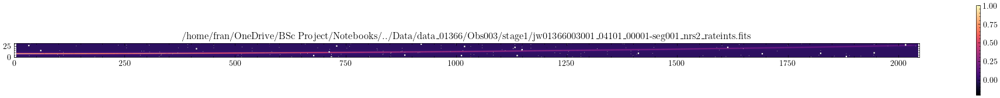

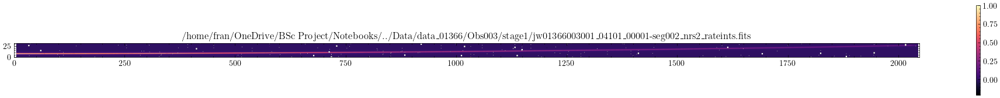

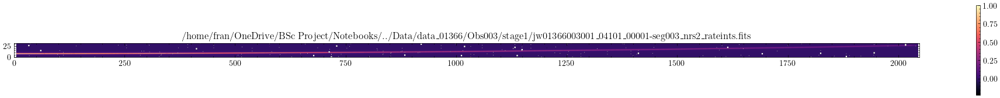

In [7]:
def plot_fits(file):
    with fits.open(file) as hdul:
        data = hdul[1].data
        #data = np.nansum(data, axis=0)
        data = data[3, :, :]
        # Normalize the data
        data = data / np.nanmax(data)
        # take only data where it is smaller than 0.05
        #data[data < 0] = 0
        #data[data > 0.0008] = 0.0008

        plt.figure(figsize=(25, 2))  # Make the figure square
        plt.imshow(data, cmap='magma', aspect='equal', origin='lower')
        plt.colorbar()
        plt.title(file)
        plt.show()

# Plot each file
for file in rateints_files:
    plot_fits(file)

In [8]:
def find_dead_pixels_1d(data, threshold = 1.3):
    for i in range(len(data)):
        if np.isnan(data[i]): # nan check
            print(f"Dead pixel found at {data[i]}, {i}")
        else: # check for sudden jumps in counts
            if i == 0:
                if absolute_change(data[i], data[i + 1]) > threshold:
                    print(f"Dead pixel found at {data[i]}, {i}")
            if i == len(data) - 1:
                if absolute_change(data[i], data[i - 1]) > threshold:
                    print(f"Dead pixel found at {data[i]}, {i}")
            else:
                if absolute_change(data[i - 1], data[i]) > threshold and absolute_change(data[i], data[i+1]) > threshold:
                    print(f"Dead pixel found at {data[i]}, {i}")

In [9]:
def find_dead_pixels_2d(data, threshold=1.3):
    rows, cols = data.shape
    dead_pixels = set()  # use a set to avoid duplicates

    # Detect individual dead pixels
    for i in range(rows):
        for j in range(cols):
            if np.isnan(data[i, j]):  # NaN check
                dead_pixels.add((i, j))
            else:
                # x-axis (left/right)
                if (j == 0 and absolute_change(data[i, j], data[i, j + 1]) > threshold) or \
                   (j == cols - 1 and absolute_change(data[i, j], data[i, j - 1]) > threshold) or \
                   (0 < j < cols - 1 and absolute_change(data[i, j], data[i, j - 1]) > threshold and 
                    absolute_change(data[i, j], data[i, j + 1]) > threshold):
                    dead_pixels.add((i, j))

                # y-axis (top/bottom)
                if (i == 0 and absolute_change(data[i, j], data[i + 1, j]) > threshold) or \
                   (i == rows - 1 and absolute_change(data[i, j], data[i - 1, j]) > threshold) or \
                   (0 < i < rows - 1 and absolute_change(data[i, j], data[i - 1, j]) > threshold and 
                    absolute_change(data[i, j], data[i + 1, j]) > threshold):
                    dead_pixels.add((i, j))

    # Detect rectangular clusters of dead pixels
    for i in range(rows - 1):
        for j in range(cols - 1):
            # Check if the current pixel and its neighbors form a rectangle
            if not np.isnan(data[i, j]) and not np.isnan(data[i + 1, j]) and \
               not np.isnan(data[i, j + 1]) and not np.isnan(data[i + 1, j + 1]):
                # Calculate the mean and standard deviation of the rectangle
                rect_values = [data[i, j], data[i + 1, j], data[i, j + 1], data[i + 1, j + 1]]
                rect_mean = np.mean(rect_values)
                rect_std = np.std(rect_values)

                # If the rectangle values are significantly different from their surroundings, mark them as dead
                if rect_std < threshold and (rect_mean < np.min(data) + threshold or rect_mean > np.max(data) - threshold):
                    dead_pixels.update([(i, j), (i + 1, j), (i, j + 1), (i + 1, j + 1)])

    # Convert back to list of lists
    return [list(pixel) for pixel in dead_pixels]

In [10]:
def interpolate_dead_pixels_simple(data, threshold=1.3, radius=3, iterations=1):
    """
    Interpolates dead pixels in a 2D array using a simple method.
    """
    # make a data copy
    data = data.copy()

    rows, cols = data.shape
    dead_pixels = find_dead_pixels_2d(data, threshold)

    for _ in range(iterations):
        for pixel in dead_pixels:
            x, y = pixel
            # Get the surrounding pixels within the specified radius
            surrounding_pixels = [(i, j) for i in range(max(0, x - radius), min(rows, x + radius + 1))
                                  for j in range(max(0, y - radius), min(cols, y + radius + 1))
                                  if (i, j) != (x, y)]

            # Calculate the mean of the surrounding pixels
            surrounding_values = [data[i, j] for i, j in surrounding_pixels if not np.isnan(data[i, j])]
            if surrounding_values:
                data[x, y] = np.mean(surrounding_values)

    return data

In [11]:
# --------------------------------------------------------

In [12]:
def absolute_change(a, b):
    """ Find the change in the order of magnitude between two values."""
    return np.abs(np.log10(abs(a)) - np.log10(abs(b)))

In [13]:
from scipy.ndimage import binary_fill_holes, binary_erosion
from scipy import ndimage

def find_closed_shape_contour(pixel_array, closed_shape_pixels):
    mask = np.zeros_like(pixel_array, dtype=bool)

    for pixel in closed_shape_pixels:
        mask[pixel[0], pixel[1]] = 1

    rows, cols = pixel_array.shape
    for row in range(rows):
        for col in range(cols):
            # Check if the pixel is part of the closed shape
            if np.isnan(pixel_array[row, col]):
                mask[row, col] = 1

    # Expand the mask by setting ones to the expanded pixel array size by one pixel
    expanded_mask = np.pad(mask, pad_width=1, mode='constant', constant_values=1)
    expanded_mask[1:-1, 1:-1] |= mask
    mask = expanded_mask

    # Fill patches of 0 surrounded by 1s with 1s, but only if the holes are <= 20 pixels in size
    labeled_array, num_features = ndimage.label(~mask)
    sizes = ndimage.sum(~mask, labeled_array, range(num_features + 1))
    for i, size in enumerate(sizes):
        if size <= 20:
            mask[labeled_array == i] = 1

    # Remove the outer pixels of each shape
    mask = binary_erosion(mask)

    # remove the edges of the mask
    mask = mask[1:-1, 1:-1]

    return mask


In [14]:
def find_dead_pixels(data, threshold=1):
    rows, cols = data.shape
    dead_pixels, closed_shape_pixels = set(), set()

    for row in range(rows - 1):
        for column in range(cols - 1):
            if np.isnan(data[row, column]):
                dead_pixels.add((row, column))

                # Check surrounding pixels for extreme jumps around NaN
                for dr in [-1, 0, 1]:
                    for dc in [-1, 0, 1]:
                        if dr == 0 and dc == 0:
                            continue
                        nr, nc = row + dr, column + dc
                        # Only consider non-NaN neighbors
                        if 0 <= nr < rows and 0 <= nc < cols and not np.isnan(data[nr, nc]):
                            # Compare this neighbor to its own neighboring pixels
                            for dr2 in [-1, 0, 1]:
                                for dc2 in [-1, 0, 1]:
                                    if dr2 == 0 and dc2 == 0:
                                        continue
                                    r2, c2 = nr + dr2, nc + dc2
                                    if 0 <= r2 < rows and 0 <= c2 < cols and not np.isnan(data[r2, c2]):
                                        if absolute_change(data[nr, nc], data[r2, c2]) > threshold:
                                            # Before marking, ensure all 8 around the NaN are valid (not NaN)
                                            neighbors = [(row + adr, column + adc)
                                                         for adr in [-1, 0, 1]
                                                         for adc in [-1, 0, 1]
                                                         if not (adr == 0 and adc == 0)]
                                            if all(0 <= rr < rows and 0 <= cc < cols and not np.isnan(data[rr, cc])
                                                   for rr, cc in neighbors):
                                                # Mark all eight pixels around the NaN
                                                for rr, cc in neighbors:
                                                    dead_pixels.add((rr, cc))
                                            # Stop further checks once flagged
                                            break
                                else:
                                    continue
                                break
                        else:
                            continue
                        break

            else:
                # Only consider “inner” pixels (not on borders)
                if 0 < row < rows-1 and 0 < column < cols-1:
                    jump_count = 0
                    for dr in [-1, 0, 1]:
                        for dc in [-1, 0, 1]:
                            if dr == 0 and dc == 0:
                                continue
                            r, c = row + dr, column + dc
                            if absolute_change(data[row, column], data[r, c]) > threshold:
                                jump_count += 1
                    if jump_count >= 2:
                        closed_shape_pixels.add((row, column))

    mask = find_closed_shape_contour(data, closed_shape_pixels)

    for i in range(rows):
        for j in range(cols):
            if mask[i, j] or np.isnan(data[i, j]):
                dead_pixels.add((i, j))
            else:
                # x-axis checks
                if (j == 0 and absolute_change(data[i, j], data[i, j + 1]) > threshold) or \
                   (j == cols - 1 and absolute_change(data[i, j], data[i, j - 1]) > threshold) or \
                   (0 < j < cols - 1 and absolute_change(data[i, j], data[i, j - 1]) > threshold and \
                    absolute_change(data[i, j], data[i, j + 1]) > threshold):
                    dead_pixels.add((i, j))
                # y-axis checks
                if (i == 0 and absolute_change(data[i, j], data[i + 1, j]) > threshold) or \
                   (i == rows - 1 and absolute_change(data[i, j], data[i - 1, j]) > threshold) or \
                   (0 < i < rows - 1 and absolute_change(data[i, j], data[i - 1, j]) > threshold and \
                    absolute_change(data[i, j], data[i + 1, j]) > threshold):
                    dead_pixels.add((i, j))

    return [list(pixel) for pixel in set(dead_pixels)]


In [15]:
def inject_radial_circle(array, plane_index, center_x, center_y, radius, value_range=(1e4, 1e7), falloff_power=4):
    """
    Injects a circular region of decreasing random values into a 3D array slice.

    Parameters:
        array (ndarray): 3D numpy array (e.g., data[plane_index, :, :]).
        plane_index (int): The index of the plane to modify.
        center_x (int): Row coordinate of the circle center.
        center_y (int): Column coordinate of the circle center.
        radius (int): Radius of the circle in pixels.
        value_range (tuple): Tuple of (min, max) random values to scale with falloff.
        falloff_power (float): Exponent to control decay shape (e.g., 1 = linear, 2 = quadratic, 3 = cubic).
    """
    for i in range(center_x - radius, center_x + radius + 1):
        for j in range(center_y - radius, center_y + radius + 1):
            dy = i - center_x
            dx = j - center_y
            dist = np.sqrt(dx**2 + dy**2)
            if dist <= radius:
                falloff = 1 - (dist / radius) + 1e-1
                base_value = np.random.uniform(*value_range)
                array[plane_index, i, j] = base_value * (falloff ** falloff_power)

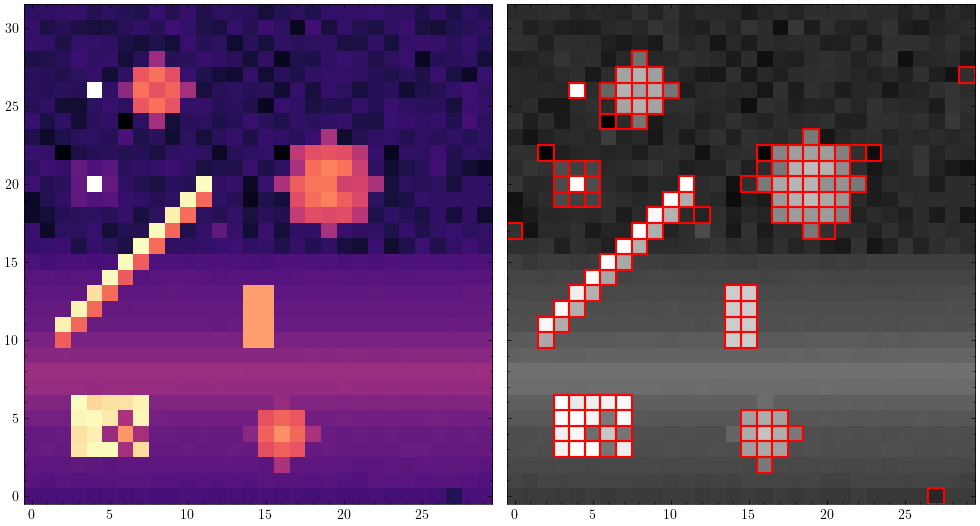

In [16]:
with fits.open(rateints_files[0]) as hdul:
    data = hdul[1].data
    original_data = np.log10(abs(data[153, :, 210:220]))

    # Introduce random values for testing
    data[153, 3:7, 253:258] = np.random.uniform(1e3, 1e10, size=(4, 5))

    # Generate a 45-degree diagonal line of high values
    for i in range(10):
        data[153, 10+i, 252+i] = np.random.uniform(1e5, 1e6)
        data[153, 11+i, 252+i] = np.random.uniform(1e3, 1e10)

    data[153, 10:14, 264:266] = 2e7

    inject_radial_circle(data, 153, 20, 269, 3)
    inject_radial_circle(data, 153, 4, 256, 1)
    inject_radial_circle(data, 153, 4, 266, 2)
    inject_radial_circle(data, 153, 26, 258, 2)

    data_slice = data[153, :, 250:280]

    # Find dead pixels
    dead_pixels = find_dead_pixels(data_slice, 1.5)

    fig, axes = plt.subplots(1, 2, figsize=(10, 6), sharex=True, sharey=True)

    # First plot: no overlays
    axes[0].imshow(np.log10(abs(data_slice)), cmap='magma', aspect='equal', origin='lower')

    # Second plot: with dead pixel boxes
    axes[1].imshow(np.log10(abs(data_slice)), cmap='grey', aspect='equal', origin='lower')
    for pixel in dead_pixels:
        x, y = pixel
        rect = plt.Rectangle((y - 0.5, x - 0.5), 1, 1, edgecolor='red', facecolor='none', lw=1.5)
        axes[1].add_patch(rect)

    # Add colorbar to the right of both plots
    plt.tight_layout()
    plt.show()


In [17]:
def split_into_segments(points):
    """
    Splits a sorted list of points into continuous segments.

    Parameters
    ----------
    points : list of int
        A sorted list of integer points.

    Returns
    -------
    list of list of int
        A list of continuous segments, where each segment is a list of integers.
    """
    segments = []
    current_segment = [points[0]]
    for i in range(1, len(points)):
        if points[i] == points[i - 1] + 1:
            current_segment.append(points[i])
        else:
            segments.append(current_segment)
            current_segment = [points[i]]
    segments.append(current_segment)
    return segments

In [18]:
from collections import deque

def interpolate_dead_pixels(data, threshold=1.5, confidence_treshold=4, max_radius=1, iterations=1):
    """
    Interpolate only the corner dead pixels of each rectangular cluster of dead pixels.

    This version first identifies corner pixels from clusters, then computes neighbors just for them.

    Parameters
    ----------
    data : 2D np.ndarray
        Input array with "dead" pixels identified by `find_dead_pixels_2d`.
    threshold : float
        Threshold passed to `find_dead_pixels_2d` to detect dead pixels.
    confidence_treshold : float
        Threshold for confidence in interpolation. If confidence is below this value, the pixel will not be interpolated.
    max_radius : int
        Search radius for candidate neighbors.
    iterations : int
        Number of iterative passes (in case interpolation cascades).

    Returns
    -------
    np.ndarray
        Copy of `data` with only corner pixels of each rectangular dead-pixel cluster interpolated.
    """
    interpolated = data.copy().astype(float)
    initial_dead_pixels = find_dead_pixels(interpolated, threshold)
    #print(initial_dead_pixels)
    for pixel in initial_dead_pixels:
        interpolated[pixel[0], pixel[1]] = np.nan

    low_confidence_pixels, high_confidence_pixels = [], []

    for _ in range(iterations):
        # 1) Detect all dead pixels and normalize to tuple coords
        dead_pixels = find_dead_pixels(interpolated, threshold)
        #print(dead_pixels)
        dead_set = {tuple(dp) for dp in dead_pixels}
        if not dead_set:
            break

        # 2) Cluster into connected components (8-connectivity)
        def get_neighbors(pt):
            r, c = pt
            for dr in (-1, 0, 1):
                for dc in (-1, 0, 1):
                    if dr == 0 and dc == 0:
                        continue
                    nbr = (r + dr, c + dc)
                    if nbr in dead_set:
                        yield nbr

        components = []
        visited = set()
        for pix in dead_set:
            if pix in visited:
                continue
            queue = deque([pix])
            comp = []
            visited.add(pix)
            while queue:
                cur = queue.popleft()
                comp.append(cur)
                for nbr in get_neighbors(cur):
                    if nbr not in visited:
                        visited.add(nbr)
                        queue.append(nbr)
            components.append(comp)

        # 3) Identify corner pixels for each component
        corner_pixels = set()
        for comp in components:
            for r, c in comp:
                non_dead_neighbors = 0
                for dr in (-1, 0, 1):
                    for dc in (-1, 0, 1):
                        if dr == 0 and dc == 0:
                            continue
                        nr, nc = r + dr, c + dc
                        if 0 <= nr < data.shape[0] and 0 <= nc < data.shape[1] and (nr, nc) not in dead_set:
                            non_dead_neighbors += 1
                if non_dead_neighbors >= 4:
                    corner_pixels.add((r, c))
        
        # Remove low confidence pixels from corner pixels
        corner_pixels.difference_update(low_confidence_pixels)
        #print(corner_pixels)

        pixels_dict = {}
        # 4) For each corner pixel, compute neighbors and interpolate
        for r, c in corner_pixels:
            candidates = []
            for dr in range(-max_radius, max_radius + 1):
                for dc in range(-max_radius, max_radius + 1):
                    nr, nc = r + dr, c + dc
                    if (dr == 0 and dc == 0) or not (0 <= nr < interpolated.shape[0] and 0 <= nc < interpolated.shape[1]):
                        continue
                    val = interpolated[nr, nc]
                    if not np.isnan(val):
                        dist = np.hypot(dr, dc)
                        candidates.append(((nr, nc), val, dist))
            pixels_dict[(r, c)] = candidates

            if not candidates:
                continue

        for pix, candidates in pixels_dict.items():
            x_points = [neighbor_coordinates[1] for neighbor_coordinates, val, dist in candidates if neighbor_coordinates[0] == pix[0]]
            x_points_vals = [val for neighbor_coordinates, val, dist in candidates if neighbor_coordinates[0] == pix[0]]

            y_points = [neighbor_coordinates[0] for neighbor_coordinates, val, dist in candidates if neighbor_coordinates[1] == pix[1]]
            y_points_vals = [val for neighbor_coordinates, val, dist in candidates if neighbor_coordinates[1] == pix[1]]

            if not x_points or not y_points:
                interpolated[pix[0], pix[1]] = np.nan
                continue
        
            # split the x_points into n lists with the break at the point where the list is not continuous
            x_segments = split_into_segments(x_points)
            x_segments = [segment for segment in x_segments if any(abs(x - pix[1]) == 1 for x in segment)]
            x_points_vals = [x_points_vals[x_points.index(x)] for segment in x_segments for x in segment]

            y_segments = split_into_segments(y_points)
            y_segments = [segment for segment in y_segments if any(abs(y - pix[0]) == 1 for y in segment)]
            y_points_vals = [y_points_vals[y_points.index(y)] for segment in y_segments for y in segment]

            x_points = [x for segment in x_segments for x in segment]
            y_points = [y for segment in y_segments for y in segment]
            
            # linear fit
            try:
                popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)
                popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)
            except np.linalg.LinAlgError as e:
                #print(f"Error during linear fit for pixel {pix}: {e}")
                interpolated[pix[0], pix[1]] = np.nan
                continue
            except ValueError as e:
                #print(f"ValueError during linear fit for pixel {pix}: {e}")
                interpolated[pix[0], pix[1]] = np.nan
                continue
            except TypeError as e:
                #print(f"TypeError during linear fit for pixel {pix}: {e}")
                interpolated[pix[0], pix[1]] = np.nan
                continue


            # Find the point value
            new_x = np.polyval(popt_x, pix[1])
            new_y = np.polyval(popt_y, pix[0])

            # Ensure correlation values are non-negative for weights
            weight_x = abs(np.std([x - (popt_x[0] * x + popt_x[1]) for x in x_points_vals]))
            weight_y = abs(np.std([y - (popt_y[0] * y + popt_y[1]) for y in y_points_vals]))

            # Normalize weights
            total_weight = 1 / weight_x + 1 / weight_y
            weight_x = (1 / weight_x) / total_weight
            weight_y = (1 / weight_y) / total_weight

            # Weighted average
            interpolated_value = weight_x * new_x + weight_y * new_y

            # Calculate confidence as the inverse of the standard deviation of residuals
            confidence_x = 1 / (np.std([x - (popt_x[0] * x + popt_x[1]) for x in x_points_vals]) + 1e-6)
            confidence_y = 1 / (np.std([y - (popt_y[0] * y + popt_y[1]) for y in y_points_vals]) + 1e-6)
            confidence = (confidence_x + confidence_y) / 2

            # Print or store confidence for debugging or analysis
            #print(f"Pixel {pix}: Interpolated value = {interpolated_value}, Confidence = {confidence}")
            if confidence < confidence_treshold:
                #print(f"Confidence too low for pixel {pix}: {confidence}")
                low_confidence_pixels.append(pix)
            else:
                high_confidence_pixels.append([pix, confidence])

            # Assign the interpolated value to the pixel
            interpolated[pix[0], pix[1]] = interpolated_value

        #remove duplicates from low confidence pixels
        low_confidence_pixels = list(set(low_confidence_pixels))
#        for pixel in low_confidence_pixels:
#            interpolated[pixel[0], pixel[1]] = np.nan

    # turn it into a dictionary
    high_confidence_pixels = {pixel[0]: pixel[1] for pixel in high_confidence_pixels}
    #print(high_confidence_pixels)
    #print(f"Overall average confidence of {np.mean(high_confidence_pixels)}")

    return interpolated, high_confidence_pixels


In [19]:
def confidences(data, high_confidence_pixels):
    full_data = np.zeros(data.shape)

    #extract the values
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            if (i,j) in high_confidence_pixels:
                full_data[i,j] = high_confidence_pixels[(i,j)]
            else:
                full_data[i,j] = np.nan

    return full_data

2025-05-19 15:07:51,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:07:51,447 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:07:51,451 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:07:51,496 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:07:51,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

[[-0.12778611  0.          0.        ]
 [-0.0759657   0.20378616  0.        ]
 [-0.08506229 -0.03451691 -0.22157774]]
[[3.8712131e+08 0.0000000e+00 0.0000000e+00]
 [6.7150904e+09 2.5412186e+09 0.0000000e+00]
 [0.0000000e+00 4.5812321e+09 8.3740531e+08]]


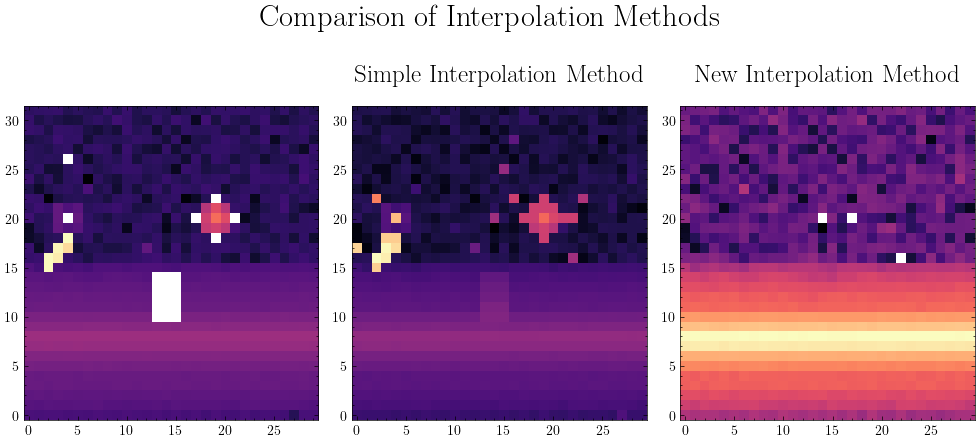

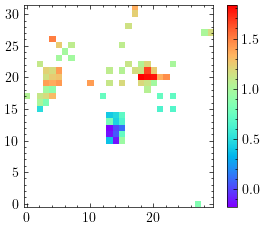

In [20]:
with fits.open(rateints_files[0]) as hdul:
    data = hdul[1].data
    original_data = np.log10(abs(data[153, :, 250:280]))
    data_saved = data[153, 15:18, 252:255].copy()

    # Introduce NaNs for testing
    data[153, 10:15, 263:266] = np.nan

    for i in range(3):
        data[153, 15+i, 252+i] = np.random.uniform(1e8, 1e10)
        data[153, 16+i, 252+i] = np.random.uniform(1e8, 1e10)

    # Create a circular region with decreasing random values from the center
    center_x, center_y = 20, 269   # Center of the circle
    radius = 2                     # Radius in pixels
    for i in range(center_x - radius, center_x + radius + 1):
        for j in range(center_y - radius, center_y + radius + 1):
            dy = i - center_x
            dx = j - center_y
            dist = np.sqrt(dx**2 + dy**2)
            if dist <= radius:
                # Linear falloff: closer to center -> higher value
                falloff = 1 - (dist / radius)  # ranges from 1 at center to 0 at edge
                base_value = np.random.uniform(1e4, 1e6)
                data[153, i, j] = base_value * falloff ** 4


    # make a circle mask of nans radius 2

    data_slice = data[153, :, 250:280]


    # Find dead pixels
    dead_pixels = find_dead_pixels(data_slice, 1.3)
    
    # Interpolate using two methods
    interpolated_data_1, confidence = interpolate_dead_pixels(data_slice, 1.3, 0.5, 3, 10)
    interpolated_data_2 = interpolate_dead_pixels_simple(data_slice, 1.3, 3, 10)

    print(interpolated_data_1[15:18, 2:5] - data_saved)
    print(interpolated_data_2[15:18, 2:5] - data_saved)

    # Log-transform interpolated data
    interpolated_data_1 = np.log10(abs(interpolated_data_1))
    interpolated_data_2 = np.log10(abs(interpolated_data_2))
    
    # Create a 2x3 graph
    fig, ax = plt.subplots(1, 3, figsize=(10,5))

    # Top row: New interpolation method
    ax[0].imshow(np.log10(abs(data_slice)), cmap='magma', aspect='equal', origin='lower')
    ax[2].imshow(interpolated_data_1, cmap='magma', aspect='equal', origin='lower')
    #im = ax[0, 2].imshow(original_data - interpolated_data_1, cmap='magma', aspect='equal', origin='lower')
    #fig.colorbar(im, ax=ax[0, 2])

    
    # Bottom row: Simple interpolation method
    #ax[].imshow(np.log10(abs(data_slice)), cmap='magma', aspect='equal', origin='lower')
    ax[1].imshow(interpolated_data_2, cmap='magma', aspect='equal', origin='lower')
    #ax[1, 2].imshow(original_data - interpolated_data_2, cmap='magma', aspect='equal', origin='lower')
    

    
    # Set global titles
    fig.suptitle("Comparison of Interpolation Methods", fontsize=22, y=0.95)
    ax[2].set_title("New Interpolation Method", fontsize=18, y=1.05)
    ax[1].set_title("Simple Interpolation Method", fontsize=18, y=1.05)
    
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.savefig(f"../Presentations/Introduction Presentation/Pictures/interpolation_comparison.pdf", bbox_inches='tight', dpi=300)
    plt.show()


    confidence = confidences(data_slice, confidence)
    plt.imshow(np.log10(confidence), cmap='rainbow', aspect='equal', origin='lower')
    plt.colorbar()
    plt.show()

2025-05-19 15:09:39,684 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:39,687 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:39,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:39,936 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:39,938 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:40,204 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:40,347 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:40,348 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:40,348 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:40,350 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:40,594 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:40,596 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:40,606 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:40,618 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:40,620 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:40,946 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:40,948 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:40,950 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:40,952 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:40,953 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:41,211 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,212 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,216 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,216 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,217 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:41,460 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,466 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:41,469 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:41,705 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,706 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,707 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,708 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:41,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,932 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:41,934 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:41,935 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:41,936 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:42,231 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:42,232 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:42,233 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:42,234 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:42,235 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:42,587 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:42,587 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:42,588 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:42,588 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:42,589 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:42,811 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:42,812 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:42,813 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:42,813 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:42,814 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:43,100 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,101 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:43,102 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,103 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,103 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:43,504 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,505 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:43,736 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:43,737 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:43,737 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,738 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,738 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:43,940 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,941 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:43,941 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:43,942 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:43,943 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:44,230 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:44,231 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:44,231 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:44,232 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:44,233 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:44,452 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:44,452 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:44,452 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:44,453 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:09:44,454 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:09:45,387 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:45,388 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:45,389 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:45,389 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:09:45,390 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


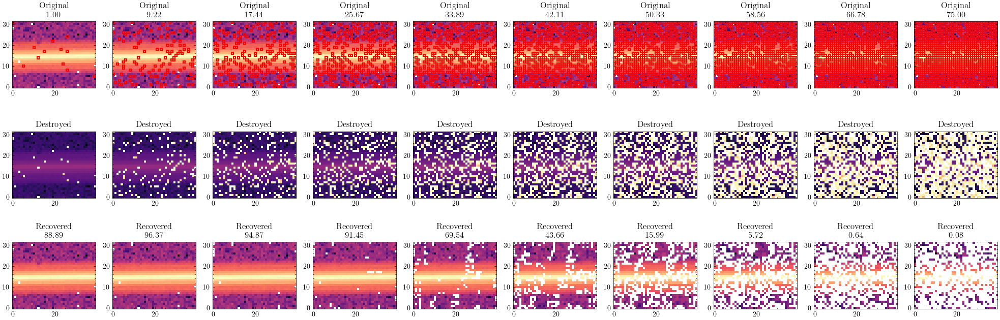

In [24]:
# ------------ DATA DESTRUCTION TEST -------------------

def random_holes(data, percentage_to_destroy=0.95, seed=42):
    np.random.seed(seed)
    data_backup = data.copy()

    # Find the indices of the pixels to destroy
    num_pixels = data.size
    num_pixels_to_destroy = int(num_pixels * percentage_to_destroy)
    indices_to_destroy = np.random.choice(num_pixels, num_pixels_to_destroy, replace=False)

    # Destroy the pixels with either np.nan or random large number
    for idx in indices_to_destroy:
        if np.random.random() < 0.5:  # 50% chance for each option
            data_backup.flat[idx] = np.nan
        else:
            data_backup.flat[idx] = np.random.uniform(1e6, 1e10)

    # using data.shape and data.size from indeces_to_destroy turn into [[x,y],[x,y],..
    coordinates_to_destroy = [np.unravel_index(idx, data.shape) for idx in indices_to_destroy]

    return data_backup, coordinates_to_destroy, indices_to_destroy


def percentage(data, interpolated_data):
    original_pixels = np.array([data.flatten()[i] for i in indices_to_destroy])
    interpolated_pixels = np.array([interpolated_data.flatten()[i] for i in indices_to_destroy])
    mask_interpolated = ~np.isnan(interpolated_pixels)

    correction_ratio = len(original_pixels[mask_interpolated]) / len(original_pixels)

    numerator = np.nansum(original_pixels[mask_interpolated])
    denominator = np.nansum(interpolated_pixels[mask_interpolated])

    if denominator == 0:
        percentage = 0  # or handle division by zero accordingly
    else:
        ratio = numerator / denominator
        if ratio > 1:
            percentage = denominator / numerator
        else:
            percentage = ratio

    return percentage * correction_ratio

def find_dead_pixels(data, threshold=1):
    return coordinates_to_destroy

with (fits.open(rateints_files[0]) as hdul):
    data = hdul[1].data
    data = data[153, :, 1250:1290]

    percentage_no = 10

    fig, ax = plt.subplots(3, percentage_no, figsize=(25, 8))  # 3 rows, 10 columns

    # Loop over destruction percentages from 0.01 to 0.10
    percentages = np.linspace(0.01, 0.75, percentage_no)
    for i, destroyed_percentage in enumerate(percentages):
        # Destroy and interpolate
        destroyed_data, coordinates_to_destroy, indices_to_destroy = random_holes(data, destroyed_percentage, seed=42)  # unique seed per run
        dead_pixels = find_dead_pixels(destroyed_data, 1.3)
        interpolated_data, confidence = interpolate_dead_pixels(destroyed_data, 1.3, 0.5, 3, 5)

        # Calculate recovery percentage
        recovered_percentage = percentage(data, interpolated_data)

        # Plot original
        ax[0, i].imshow(np.log10(abs(data)), cmap='magma', aspect='equal', origin='lower')
        ax[0, i].set_title(f"Original\n{destroyed_percentage:.2%} destroyed")

        # Plot destroyed
        ax[1, i].imshow(np.log10(abs(destroyed_data)), cmap='magma', aspect='equal', origin='lower')
        ax[1, i].set_title("Destroyed")
        for pixel in dead_pixels:
            x, y = pixel  # Swap x and y to match 01 instead of 10
            rect = plt.Rectangle((y - 0.5, x - 0.5), 1, 1, edgecolor='red', facecolor='none', lw=1.5)
            ax[0, i].add_patch(rect)

        # Plot interpolated
        ax[2, i].imshow(np.log10(abs(interpolated_data)), cmap='magma', aspect='equal', origin='lower')
        ax[2, i].set_title(f"Recovered\n{recovered_percentage:.2%}")


2025-05-19 15:23:46,296 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:46,831 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:47,446 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:47,451 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:48,494 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:48,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:49,285 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:49,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:49,292 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:50,209 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:50,216 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:50,217 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:50,223 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:50,224 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:51,218 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:51,221 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:51,228 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:51,229 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:51,230 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:52,375 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:52,378 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:52,385 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:52,386 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:52,387 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:53,571 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:53,574 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:53,583 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:53,584 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:53,585 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:54,970 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:54,974 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:54,983 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:54,984 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:54,985 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:55,274 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:56,504 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:56,505 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:56,509 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:56,510 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:56,761 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:56,780 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:56,855 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:58,059 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:58,062 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:23:58,321 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:23:58,338 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:58,416 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:59,777 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:23:59,780 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:00,036 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:00,044 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:00,059 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:00,148 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:01,571 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:01,819 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:01,826 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:01,843 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:01,845 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:01,918 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:03,500 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:03,501 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:03,502 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:03,503 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:03,505 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:03,729 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:03,736 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:03,752 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:03,753 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:03,763 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:05,558 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:05,560 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:05,561 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:05,561 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:05,562 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:05,761 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:05,813 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:05,820 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:05,824 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:05,837 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:07,774 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:07,776 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:07,777 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:07,778 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:07,779 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:07,991 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:07,995 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:08,007 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:08,008 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:08,016 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:09,985 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:09,986 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:09,987 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:09,989 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:09,991 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:10,218 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:10,220 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:10,224 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:10,234 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:10,235 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:10,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:10,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:10,488 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:10,497 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:12,316 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:12,572 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:12,574 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:12,575 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:12,579 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:12,589 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:12,816 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:12,838 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:12,847 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:14,765 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:14,766 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:15,016 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:15,018 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:15,019 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:15,024 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:15,034 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:15,293 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:15,303 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:15,306 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:15,327 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:15,330 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:17,585 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:17,586 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:17,587 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:17,631 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:17,633 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:17,880 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:17,882 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:17,883 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:17,903 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:17,906 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:19,987 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:19,988 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:19,989 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:19,990 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:19,992 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:20,257 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:20,258 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:20,259 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:20,263 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:20,264 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:20,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:20,504 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:20,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:20,510 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:20,515 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:22,663 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:22,664 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:22,664 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:22,666 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:22,667 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:22,943 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:22,943 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:22,946 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:22,948 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:22,949 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:23,217 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:23,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:23,223 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:23,228 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:23,229 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:25,518 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:25,519 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:25,519 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:25,521 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:25,522 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:25,806 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:25,807 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:25,810 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:25,811 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:25,813 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:26,070 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:26,074 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:26,075 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:26,078 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:26,081 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:28,363 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:28,363 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:28,364 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:28,365 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:28,366 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:28,587 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:28,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:28,595 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:28,598 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:28,599 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:28,937 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:28,941 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:28,942 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:28,944 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:28,947 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:31,240 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:31,241 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:31,241 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:31,242 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:31,243 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:31,473 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:31,477 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:31,479 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:31,481 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:31,482 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:31,786 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:31,788 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:31,789 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:31,796 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:31,797 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:34,238 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,239 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,240 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,241 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,242 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:34,470 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,473 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:34,475 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,475 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,476 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:34,690 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,694 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:34,695 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:34,922 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:34,923 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:34,926 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:34,928 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:34,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:37,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,443 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,443 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,444 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,445 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:37,659 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,659 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:37,887 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,888 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,889 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:37,890 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:37,890 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:40,188 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,189 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,190 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,191 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:40,415 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:40,416 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:40,420 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,422 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:40,423 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:40,666 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,667 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,669 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:40,670 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,672 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:40,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,896 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:40,897 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,902 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:40,904 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:43,427 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:43,427 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:43,428 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:43,429 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:43,430 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:43,654 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:43,655 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:43,656 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:43,657 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:43,658 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:43,866 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:43,869 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:43,870 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:43,870 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:43,871 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:44,158 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:44,162 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:44,163 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:44,164 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:44,165 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:46,795 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:46,796 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:46,797 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:46,797 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:46,798 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:47,020 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:47,022 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:47,022 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:47,023 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:47,024 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:47,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:47,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:47,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:47,291 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:47,291 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:47,518 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:47,519 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:47,520 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:47,526 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:47,527 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:50,425 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:50,426 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:50,428 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:50,428 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:50,429 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:50,630 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:50,631 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:50,632 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:50,633 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:50,633 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:50,926 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:50,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:50,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:50,931 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:50,932 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:53,481 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:53,482 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:53,482 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:53,483 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:53,484 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:53,715 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:53,716 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:53,717 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:53,717 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:53,718 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:54,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:54,050 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:54,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:54,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:54,053 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:56,806 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:56,807 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:56,807 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:56,808 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:56,808 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:57,041 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:57,041 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:57,042 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:57,044 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:57,044 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:57,247 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:57,249 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:57,250 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:57,251 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:57,254 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:24:57,557 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:57,558 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:24:57,558 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:57,559 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:24:57,562 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:00,269 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:00,269 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:00,270 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:00,271 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:00,272 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:00,505 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:00,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:00,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:00,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:00,509 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:00,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:00,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:00,710 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:00,711 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:00,714 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:01,055 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:01,057 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:01,058 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:01,059 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:01,060 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:03,877 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:03,878 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:03,878 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:03,879 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:03,880 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:04,204 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,205 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,206 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,207 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,207 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:04,440 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:04,443 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:04,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:04,665 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:04,665 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:04,666 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:07,804 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:07,805 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:07,806 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:07,806 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:07,807 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:08,090 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:08,091 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:08,092 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:08,093 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:08,094 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:08,301 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:08,303 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:08,303 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:08,304 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:11,022 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:11,320 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:11,320 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:11,321 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:11,322 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:11,322 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:11,552 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:11,553 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:11,554 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:11,555 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:11,556 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:14,572 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:14,573 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:14,574 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:14,575 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:14,576 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:14,959 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:14,959 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:14,960 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:14,960 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:14,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:15,551 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:15,552 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:15,553 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:15,554 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:15,554 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:18,666 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:18,666 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:18,667 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:18,668 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:18,669 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:19,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:19,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:19,050 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:19,051 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:19,055 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:19,397 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:19,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:19,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:19,400 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:19,400 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:22,684 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:22,684 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:22,686 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:22,688 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:22,689 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:22,999 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:23,000 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:23,001 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:23,001 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:23,002 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:26,343 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:26,344 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:26,345 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:26,346 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:26,347 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:26,643 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:26,644 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:26,645 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:26,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:26,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:29,941 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:29,942 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:29,943 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:29,943 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:29,944 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:30,223 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:30,224 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:30,225 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:30,226 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:30,226 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:33,643 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:33,644 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:33,645 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:33,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:33,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:33,939 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:33,940 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:33,941 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:33,942 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:33,942 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:37,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,050 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,050 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:37,327 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,328 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:37,329 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,329 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,331 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:37,606 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:37,608 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:37,610 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:40,869 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:40,870 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:40,870 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:40,871 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:40,871 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:41,155 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:41,155 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:41,156 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:41,156 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:41,158 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:41,438 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:41,439 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:41,439 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:41,440 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:41,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:44,586 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:44,587 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:44,587 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:44,588 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:44,588 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:44,874 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:44,875 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:44,877 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:44,878 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:44,879 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:45,140 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:45,140 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:45,141 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:45,142 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:45,142 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:48,285 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:48,286 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:48,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:48,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:48,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:48,568 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:48,569 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:48,569 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:48,570 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:48,572 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:48,817 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:48,818 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:51,927 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:51,928 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:51,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:51,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:51,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:52,215 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:52,216 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:52,216 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:52,217 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:52,218 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:52,453 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:52,454 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:52,454 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:52,454 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:52,455 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:55,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:55,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:55,592 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:55,592 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:55,593 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:55,887 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:55,889 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:55,890 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:55,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:55,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:59,139 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:59,140 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:59,140 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:59,141 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:59,141 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:25:59,391 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:59,391 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:59,393 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:25:59,393 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:25:59,394 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:02,653 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:02,654 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:02,655 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:02,655 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:02,656 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:02,925 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:02,925 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:02,926 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:02,926 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:02,926 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:06,125 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:06,126 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:06,127 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:06,127 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:06,128 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:06,417 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:06,418 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:06,418 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:06,419 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:06,419 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:09,553 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:09,554 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:09,554 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:09,555 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:09,555 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:09,820 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:09,821 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:09,822 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:09,823 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:09,824 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:13,002 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:13,003 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:13,004 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:13,005 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:13,005 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:13,243 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:13,244 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:13,244 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:13,245 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:13,245 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:16,470 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:16,471 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:16,472 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:16,473 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:16,473 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:16,704 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:16,704 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:16,705 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:16,705 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:16,707 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:19,852 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:19,852 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:19,853 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:19,854 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:19,855 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:32,874 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:32,877 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:32,881 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:32,884 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:32,886 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:34,370 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:34,371 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:34,372 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:34,374 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:34,377 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:35,939 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:35,940 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:35,941 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:35,943 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:35,947 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:37,645 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:37,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:37,647 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:37,651 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:37,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:39,436 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:39,436 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:39,437 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:39,440 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:39,447 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:39,749 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:41,369 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:41,370 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:41,370 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:41,373 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:41,376 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:41,622 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:41,622 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:41,685 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:41,714 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:41,771 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:43,432 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:43,433 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:43,433 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:43,435 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:43,438 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:45,831 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:45,840 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:45,842 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:45,854 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:45,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:48,011 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:48,013 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:48,019 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:48,023 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:48,036 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:48,246 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:48,249 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:48,254 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:48,260 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:48,264 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:50,359 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:50,360 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:50,364 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:50,369 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:50,376 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:50,613 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:50,614 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:50,618 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:50,630 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:50,636 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:52,807 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:52,810 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:52,815 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:52,818 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:52,820 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:53,081 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:53,084 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:53,095 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:53,109 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:53,117 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:55,103 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:55,105 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:55,106 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:55,107 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:55,108 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:55,381 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:55,384 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:55,388 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:55,390 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:55,396 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:55,675 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:55,677 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:55,680 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:55,691 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:55,694 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:57,716 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:57,718 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:57,719 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:57,719 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:57,721 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:57,998 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:57,999 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:58,000 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:58,004 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:58,008 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:26:58,273 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:58,277 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:26:58,279 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:58,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:26:58,290 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:00,462 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:00,464 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:00,465 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:00,465 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:00,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:00,701 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:00,702 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:00,708 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:00,710 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:00,711 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:01,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:01,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:01,062 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:01,071 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:01,075 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:03,377 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:03,380 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:03,380 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:03,381 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:03,382 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:03,617 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:03,620 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:03,621 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:03,622 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:03,623 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:03,865 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:03,868 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:03,869 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:03,870 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:03,875 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:04,111 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:04,112 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:04,114 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:06,342 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:06,345 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:06,581 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:06,582 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:06,585 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:06,588 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:06,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:06,810 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:06,813 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:06,814 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:06,814 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:06,816 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:07,063 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:07,071 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:07,073 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:07,074 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:07,075 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:09,579 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:09,581 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:09,582 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:09,583 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:09,586 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:09,829 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:09,832 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:09,832 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:09,833 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:09,835 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:10,080 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:10,081 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:10,082 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:10,085 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:10,085 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:12,439 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:12,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:12,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:12,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:12,444 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:12,686 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:12,689 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:12,691 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:12,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:12,694 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:12,983 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:12,987 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:12,989 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:12,990 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:12,993 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:13,252 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:13,253 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:13,254 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:13,256 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:13,265 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:16,051 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:16,054 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:16,056 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:16,057 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:16,058 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:16,309 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:16,314 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:16,315 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:16,315 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:16,317 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:16,582 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:16,584 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:16,585 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:16,588 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:16,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:19,153 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,155 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,156 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,156 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,157 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:19,397 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:19,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,400 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:19,623 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:19,624 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,625 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:19,625 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,677 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:19,938 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,939 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,941 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:19,942 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:19,944 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:22,633 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:22,634 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:22,636 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:22,637 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:22,637 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:22,889 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:22,890 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:22,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:22,893 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:22,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:23,116 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:23,118 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:23,119 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:23,122 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:23,123 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:23,321 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:23,325 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:23,327 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:23,329 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:23,330 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:26,017 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,019 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,020 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,021 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,021 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:26,259 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:26,261 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,262 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:26,262 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:26,263 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:26,493 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:26,494 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:26,495 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,496 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:26,836 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,837 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:26,841 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:26,842 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:26,844 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:29,545 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:29,546 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:29,546 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:29,548 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:29,548 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:29,788 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:29,789 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:29,789 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:29,791 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:29,791 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:30,018 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:30,020 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:30,022 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:30,024 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:30,027 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:30,351 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:30,352 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:30,353 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:30,355 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:30,356 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:33,445 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,447 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,448 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,448 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,448 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:33,689 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,690 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,694 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:33,938 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:33,939 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:33,940 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:33,941 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:33,942 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:34,280 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:34,282 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:34,283 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:34,283 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:34,285 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:37,191 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,193 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,194 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,194 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:37,433 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:37,434 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,437 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,437 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,438 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:37,670 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,671 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:37,671 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:37,672 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:37,672 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:38,002 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:38,003 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:38,004 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:38,005 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:38,006 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:40,811 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:40,812 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:40,813 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:40,814 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:40,814 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:41,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,050 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,051 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,053 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:41,298 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,299 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:41,300 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,301 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:41,302 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:41,644 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,645 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,647 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:41,648 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:44,684 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:44,685 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:44,687 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:44,687 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:44,688 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:44,924 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:44,925 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:44,925 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:44,926 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:44,928 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:45,175 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:45,176 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:45,177 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:45,178 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:45,178 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:45,376 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:45,376 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:45,377 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:45,379 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:45,444 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:48,343 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,344 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,345 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,346 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,346 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:48,579 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,579 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,580 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:48,581 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,581 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:48,794 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,795 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:48,797 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:48,798 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:48,800 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:49,098 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:49,099 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:49,100 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:49,101 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:49,101 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:51,979 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:51,980 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:51,980 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:51,981 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:51,982 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:52,214 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:52,214 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:52,215 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:52,216 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:52,216 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:52,464 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:52,466 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:52,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:52,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:52,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:52,724 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:52,725 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:52,726 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:52,728 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:52,729 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:55,748 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:55,750 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:55,750 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:55,751 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:55,752 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:55,986 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:55,988 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:55,989 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:55,989 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:55,990 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:56,240 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:56,241 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:56,242 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:56,242 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:56,243 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:56,545 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:56,546 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:56,546 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:56,547 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:56,549 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:59,374 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,376 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,376 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,377 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,378 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:59,607 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,607 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,608 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:27:59,610 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:27:59,831 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,832 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,833 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,834 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:27:59,834 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:00,074 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:00,076 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:00,077 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:00,078 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:00,079 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:03,046 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,047 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,047 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:03,274 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:03,275 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:03,275 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:03,276 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,277 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:03,495 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,496 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,497 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:03,731 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:03,731 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,732 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:03,733 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:03,734 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:06,618 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:06,619 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:06,620 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:06,621 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:06,621 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:06,893 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:06,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:06,895 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:06,897 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:06,897 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:07,127 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:07,128 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:07,129 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:07,129 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:07,177 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:10,129 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,130 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,130 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,131 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,131 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:10,397 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,400 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,401 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,402 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:10,658 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:10,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:13,774 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:13,775 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:13,776 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:13,777 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:13,777 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:14,028 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:14,029 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:14,030 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:14,031 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:14,031 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:14,261 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:14,262 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:14,263 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:14,265 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:14,267 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:17,341 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:17,342 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:17,343 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:17,343 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:17,344 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:17,588 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:17,589 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:17,590 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:17,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:17,592 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:17,805 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:17,805 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:17,806 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:17,807 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:17,808 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:21,054 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,055 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,055 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,056 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:21,056 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:21,286 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:21,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,289 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:21,540 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,541 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,541 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:21,542 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:21,543 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:24,712 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:24,713 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:24,713 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:24,714 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:24,715 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:24,928 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:24,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:24,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:24,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:24,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:25,176 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:25,177 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:25,177 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:25,178 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:25,179 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:28,370 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:28,371 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:28,371 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:28,372 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:28,373 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:28,583 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:28,584 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:28,584 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:28,585 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:28,586 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:28,788 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:28,789 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:28,790 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:28,790 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:28,791 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:31,980 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:31,981 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:31,981 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:31,982 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:31,982 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:32,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:32,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:32,193 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:32,193 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:32,194 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:35,617 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:35,618 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:35,618 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:35,619 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:35,620 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:35,826 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:35,827 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:35,828 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:35,829 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:35,829 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:39,047 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:39,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:39,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:39,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:39,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:39,280 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:39,281 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:39,282 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:39,282 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:39,283 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:42,410 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:42,411 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:42,412 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:42,413 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:42,413 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:42,637 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:42,638 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:42,638 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:42,639 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:42,639 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:46,013 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:46,014 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:46,015 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:46,015 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:46,016 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:46,221 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:46,221 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:46,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:46,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:46,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:49,394 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:49,395 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:49,396 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:49,396 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:49,397 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:49,604 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:49,605 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:49,606 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:49,606 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:49,607 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:52,948 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:52,948 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:52,949 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:52,950 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:52,950 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:53,167 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:53,168 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:53,168 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:53,169 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:53,170 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:56,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:56,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:56,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:56,289 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:56,289 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:56,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:56,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:28:56,508 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:56,510 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:56,510 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:28:59,753 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:59,754 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:59,754 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:59,754 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:28:59,755 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:11,171 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:11,174 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:11,178 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:11,179 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:11,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:11,447 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:12,619 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:12,622 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:12,623 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:12,628 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:12,834 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:12,898 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:12,968 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:14,351 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:14,353 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:14,567 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:14,636 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:16,059 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:16,061 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:16,063 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:16,292 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:16,370 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:17,908 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:17,910 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:17,912 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:18,163 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:18,171 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:18,181 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:18,249 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:19,729 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:19,945 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:19,970 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:19,973 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:20,022 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:20,032 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:21,878 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:21,881 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:21,936 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:21,949 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:21,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:23,923 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:23,975 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:23,992 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:24,066 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:25,773 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:25,775 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:25,775 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:25,776 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:25,777 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:25,990 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:25,991 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:26,000 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:26,012 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:26,021 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:26,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:28,086 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:28,087 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:28,087 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:28,090 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:28,092 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:28,334 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:28,337 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:28,343 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:28,350 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:28,364 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:30,574 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:30,575 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:30,576 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:30,578 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:30,582 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:30,825 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:30,829 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:30,833 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:30,835 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:30,837 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:31,120 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:31,132 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:33,086 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:33,087 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:33,090 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:33,093 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:33,093 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:33,350 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:33,358 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:33,361 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:33,362 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:33,366 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:33,631 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:33,635 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:33,645 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:33,656 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:33,668 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:35,796 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:35,798 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:35,800 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:35,803 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:35,804 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:36,078 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:36,080 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:36,088 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:36,092 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:36,093 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:36,371 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:36,373 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:36,377 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:36,388 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:36,403 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:38,493 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:38,494 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:38,496 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:38,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:38,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:38,777 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:38,787 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:38,790 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:38,792 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:38,796 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:39,070 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:39,072 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:39,076 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:39,086 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:39,093 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:41,304 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:41,306 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:41,310 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:41,313 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:41,314 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:41,596 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:41,607 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:41,610 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:41,611 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:41,616 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:41,889 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:41,890 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:41,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:41,898 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:41,905 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:44,184 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:44,186 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:44,188 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:44,190 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:44,191 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:44,503 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:44,505 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:44,515 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:44,518 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:44,520 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:44,811 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:44,818 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:44,819 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:44,821 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:44,822 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:47,150 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:47,152 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:47,154 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:47,157 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:47,158 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:47,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:47,470 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:47,476 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:47,479 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:47,483 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:47,775 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:47,784 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:47,788 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:47,791 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:47,797 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:50,163 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:50,164 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,168 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,170 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,171 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:50,392 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,394 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,395 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:50,396 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,397 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:50,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:50,648 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,654 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,656 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,657 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:50,875 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:50,880 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:50,881 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,882 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:50,883 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:53,128 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:53,129 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:53,131 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:53,132 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:53,133 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:53,354 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:53,355 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:53,357 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:53,359 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:53,360 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:53,613 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:53,615 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:53,619 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:53,625 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:53,629 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:54,123 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:54,127 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:54,133 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:54,134 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:54,138 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:56,530 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:56,532 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:56,534 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:56,534 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:56,535 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:56,754 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:56,755 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:56,756 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:56,758 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:56,759 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:56,969 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:56,969 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:56,972 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:56,973 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:57,028 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:57,257 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:57,258 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:57,260 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:57,260 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:57,265 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:59,664 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:59,665 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:59,667 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:59,668 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:59,669 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:29:59,890 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:59,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:59,893 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:29:59,895 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:29:59,896 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:00,110 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:00,111 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:00,112 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:00,113 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:00,114 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:00,398 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:00,407 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:00,410 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:00,411 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:00,417 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:03,170 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:03,171 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,172 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,173 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,174 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:03,404 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,405 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,406 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,407 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:03,407 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:03,629 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,631 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,632 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:03,633 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:03,633 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:03,886 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:03,889 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,896 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:03,898 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:06,668 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:06,669 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:06,669 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:06,670 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:06,671 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:06,893 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:06,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:06,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:06,895 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:06,897 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:07,118 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:07,119 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:07,119 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:07,120 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:07,121 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:07,435 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:07,436 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:07,438 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:07,439 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:07,440 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:10,107 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,108 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,109 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,110 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,111 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:10,331 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:10,333 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,334 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:10,335 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,336 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:10,552 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,553 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:10,555 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:10,555 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,556 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:10,861 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,864 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:10,866 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:10,867 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:10,870 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:13,536 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:13,537 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:13,538 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:13,539 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:13,540 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:13,760 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:13,761 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:13,762 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:13,763 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:13,764 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:13,992 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:13,993 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:13,994 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:13,995 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:13,996 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:14,306 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:14,306 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:14,307 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:14,308 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:14,308 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:17,003 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,004 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,004 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,005 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,006 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:17,229 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,230 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,233 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:17,235 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,236 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:17,450 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,450 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,452 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:17,452 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:17,453 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:17,762 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,763 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:17,765 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:17,766 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:17,767 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:20,742 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:20,743 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:20,744 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:20,745 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:20,746 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:20,966 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:20,967 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:20,968 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:20,968 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:20,969 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:21,184 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:21,185 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:21,187 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:21,188 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:21,188 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:21,493 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:21,495 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:21,496 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:21,496 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:21,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:24,347 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,348 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,348 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,349 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,350 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:24,572 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,573 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,574 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,575 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,576 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:24,780 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:24,781 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,781 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:24,782 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:24,783 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:25,001 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:25,003 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:25,003 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:25,005 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:25,006 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:27,908 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:27,909 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:27,909 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:27,910 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:27,911 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:28,132 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:28,132 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:28,133 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:28,134 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:28,135 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:28,358 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:28,359 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:28,360 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:28,360 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:28,362 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:28,563 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:28,563 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:28,564 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:28,565 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:28,565 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:31,543 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,544 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,544 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,544 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,545 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:31,769 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,769 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:31,770 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:31,770 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,771 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:31,974 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,976 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:31,977 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,977 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:31,978 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:32,198 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:32,200 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:32,201 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:32,201 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:32,201 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:35,109 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,110 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,111 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,111 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,111 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:35,344 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,345 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,346 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,347 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,347 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:35,697 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,698 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,698 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:35,699 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:35,701 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:38,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:38,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:38,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:38,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:38,663 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:38,890 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:38,890 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:38,892 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:38,892 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:38,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:39,212 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:39,212 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:39,213 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:39,213 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:39,214 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:42,253 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,254 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,254 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,255 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,255 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:42,485 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:42,486 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,487 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,487 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,488 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:42,793 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,794 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,795 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,797 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:42,798 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:45,744 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:45,745 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:45,745 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:45,745 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:45,746 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:45,973 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:45,974 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:45,975 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:45,975 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:45,976 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:46,274 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:46,275 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:46,276 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:46,277 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:46,278 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:49,320 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,320 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,321 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,321 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,322 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:49,562 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:49,562 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,563 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,563 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,614 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:49,863 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,901 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:49,902 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,903 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:49,904 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:52,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:52,964 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:52,965 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:52,966 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:52,966 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:53,234 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:53,235 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:53,236 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:53,236 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:53,237 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:53,494 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:53,497 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:53,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:53,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:53,500 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:56,522 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:56,523 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:56,524 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:56,524 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:56,525 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:56,760 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:56,761 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:56,762 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:56,763 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:56,764 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:30:57,002 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:57,002 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:57,003 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:30:57,004 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:30:57,005 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:00,019 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:00,020 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:00,021 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:00,021 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:00,022 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:00,264 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:00,265 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:00,265 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:00,266 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:00,268 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:00,528 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:00,529 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:00,530 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:00,530 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:00,531 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:03,449 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:03,450 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:03,450 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:03,450 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:03,451 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:03,678 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:03,680 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:03,681 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:03,681 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:03,682 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:03,892 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:03,893 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:03,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:03,895 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:03,895 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:06,967 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:06,967 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:06,968 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:06,969 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:06,970 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:07,198 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:07,199 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:07,200 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:07,201 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:07,202 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:07,422 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:07,423 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:07,424 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:07,425 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:07,425 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:10,432 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:10,433 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:10,433 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:10,434 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:10,434 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:10,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:10,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:10,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:10,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:10,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:10,870 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:10,871 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:10,872 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:10,873 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:10,873 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:13,807 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:13,808 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:13,808 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:13,809 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:13,809 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:14,035 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:14,035 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:14,036 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:14,037 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:14,037 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:14,247 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:14,248 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:14,250 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:14,251 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:14,252 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:17,076 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:17,077 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:17,077 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:17,078 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:17,079 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:17,297 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:17,298 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:17,299 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:17,299 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:17,300 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:20,256 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:20,257 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:20,257 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:20,258 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:20,258 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:20,478 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:20,479 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:20,480 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:20,481 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:20,482 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:23,615 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:23,616 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:23,616 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:23,617 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:23,617 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:23,837 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:23,838 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:23,839 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:23,840 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:23,840 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:26,971 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:26,971 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:26,972 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:26,973 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:26,974 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:27,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:27,193 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:27,193 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:27,194 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:27,194 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:30,309 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:30,310 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:30,311 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:30,311 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:30,312 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:30,523 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:30,523 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:30,524 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:30,525 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:30,526 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:33,505 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:33,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:33,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:33,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:33,508 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:33,716 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:36,770 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:36,771 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:36,772 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:36,773 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:31:42,053 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:42,060 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:42,064 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:31:42,069 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:31:42,105 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:06,333 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:06,335 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:06,338 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:06,338 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:06,342 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:06,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:06,612 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:06,620 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:06,629 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:06,632 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:08,561 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:08,562 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:08,563 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:08,563 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:08,564 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:08,784 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:08,785 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:08,788 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:08,795 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:08,796 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:09,025 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:09,027 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:09,031 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:09,032 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:09,033 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:11,100 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:11,101 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:11,102 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:11,102 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:11,104 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:11,332 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:11,333 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:11,334 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:11,334 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:11,335 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:11,689 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:11,690 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:11,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:11,694 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:11,695 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:13,676 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:13,677 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:13,678 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:13,678 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:13,679 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:14,173 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:14,174 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:14,175 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:14,176 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:14,177 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:14,407 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:14,409 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:14,410 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:14,413 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:14,413 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:14,724 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:14,728 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:16,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:16,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:16,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:16,921 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:16,922 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:16,925 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:16,927 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:16,928 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:17,167 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:17,168 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:17,171 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:17,173 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:17,174 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:17,389 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:17,398 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:17,401 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:17,405 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:19,471 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:19,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:19,695 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:19,699 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:19,773 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:19,776 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:19,910 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:19,912 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:19,913 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:19,914 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:19,917 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:20,141 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:20,144 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:20,145 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:20,149 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:20,153 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:22,503 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:22,504 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:22,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:22,510 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:22,511 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:22,741 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:22,743 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:22,744 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:22,744 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:22,748 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:22,966 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:22,968 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:22,970 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:22,971 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:22,975 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:25,358 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:25,359 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:25,360 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:25,362 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:25,363 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:25,577 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:25,577 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:25,582 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:25,584 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:25,590 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:25,867 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:25,868 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:25,873 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:25,874 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:25,875 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:28,101 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,102 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,103 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,104 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,105 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:28,325 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:28,326 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,326 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,327 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,328 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:28,537 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:28,539 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:28,540 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,541 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:28,542 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:28,837 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,838 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,839 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:28,841 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:28,853 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:31,173 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:31,174 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:31,175 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,176 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,177 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:31,393 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:31,393 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,395 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:31,397 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:31,605 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,606 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,606 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,607 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:31,608 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:31,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:31,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,932 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:31,933 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:34,513 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:34,514 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:34,515 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:34,516 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:34,517 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:34,738 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:34,790 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:34,792 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:34,792 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:34,793 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:35,016 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:35,016 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:35,018 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:35,019 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:35,021 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:37,423 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:37,424 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:37,424 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:37,426 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:37,427 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:37,647 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:37,647 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:37,650 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:37,651 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:37,652 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:37,852 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:37,855 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:37,858 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:37,859 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:37,860 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:38,060 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:38,061 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:38,111 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:38,112 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:38,114 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:40,611 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:40,611 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:40,612 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:40,614 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:40,615 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:40,830 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:40,830 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:40,831 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:40,832 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:40,833 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:41,042 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:41,042 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:41,044 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:41,045 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:41,047 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:41,311 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:41,312 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:41,314 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:41,315 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:41,316 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:43,886 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:43,887 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:43,888 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:43,889 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:43,889 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:44,105 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:44,106 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:44,106 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:44,107 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:44,109 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:44,313 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:44,314 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:44,315 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:44,316 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:44,318 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:44,528 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:44,529 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:44,530 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:44,580 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:44,581 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:44,735 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:44,737 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:47,202 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:47,203 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,203 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,204 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,204 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:47,424 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,425 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,426 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,426 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,426 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:47,688 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,690 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,691 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:47,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:47,914 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,917 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,920 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,920 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:47,921 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:50,504 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:50,504 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:50,505 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:50,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:50,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:50,725 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:50,726 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:50,726 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:50,727 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:50,729 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:50,933 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:50,934 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:50,935 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:50,937 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:50,938 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:51,187 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:51,189 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:51,190 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:51,191 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:51,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:53,839 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:53,840 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:53,841 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:53,841 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:53,842 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:54,065 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:54,065 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:54,067 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:54,067 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:54,069 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:54,297 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:54,300 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:54,302 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:54,304 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:54,305 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:54,513 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:54,515 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:54,516 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:54,517 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:54,517 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:57,205 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:57,206 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,207 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,208 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,209 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:57,431 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,433 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:57,433 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,434 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,435 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:57,643 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:57,644 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:57,647 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:57,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:57,892 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:57,893 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:57,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:57,895 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:32:58,099 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:58,100 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:58,100 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:32:58,102 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:32:58,103 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:00,790 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:00,791 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:00,792 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:00,792 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:00,793 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:01,060 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:01,061 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:01,064 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:01,067 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:01,068 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:01,284 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:01,285 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:01,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:01,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:01,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:01,581 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:01,582 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:01,584 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:01,585 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:01,586 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:04,220 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:04,221 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,223 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:04,453 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,454 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,455 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,456 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:04,457 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:04,680 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:04,682 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:04,682 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:04,683 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,736 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:04,894 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:04,896 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,897 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,898 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:04,898 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:07,733 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:07,734 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:07,735 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:07,735 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:07,735 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:07,965 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:07,966 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:07,968 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:07,968 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:07,970 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:08,240 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:08,241 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:08,242 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:08,242 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:08,243 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:08,473 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:08,476 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:08,478 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:08,479 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:08,480 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:11,295 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:11,297 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:11,297 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:11,298 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:11,298 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:11,529 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:11,529 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:11,530 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:11,531 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:11,532 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:11,796 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:11,797 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:11,798 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:11,798 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:11,799 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:12,031 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:12,032 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:12,034 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:12,036 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:12,039 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:14,854 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:14,855 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:14,856 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:14,856 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:14,857 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:15,086 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:15,086 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:15,087 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:15,088 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:15,089 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:15,325 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:15,327 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:15,328 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:15,329 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:15,330 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:15,565 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:15,566 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:15,567 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:15,570 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:15,572 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:18,351 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:18,352 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:18,353 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:18,354 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:18,355 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:18,553 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:18,554 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:18,555 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:18,556 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:18,557 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:18,804 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:18,805 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:18,805 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:18,807 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:18,808 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:19,008 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:19,008 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:19,010 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:19,011 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:19,012 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:21,757 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:21,758 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:21,759 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:21,760 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:21,761 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:21,961 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:21,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:21,964 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:21,966 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:21,968 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:22,201 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:22,202 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:22,203 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:22,204 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:22,205 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:22,404 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:22,405 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:22,406 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:22,407 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:22,408 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:25,404 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:25,406 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:25,407 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:25,408 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:25,409 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:25,608 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:25,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:25,610 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:25,612 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:25,612 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:25,843 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:25,845 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:25,846 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:25,847 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:25,848 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:26,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:26,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:26,050 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:26,051 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:26,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:28,927 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:28,928 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:28,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:28,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:28,931 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:29,130 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:29,131 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:29,132 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:29,133 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:29,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:29,397 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:29,398 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:29,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:29,400 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:29,401 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:32,464 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:32,466 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:32,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:32,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:32,469 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:32,700 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:32,702 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:32,702 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:32,703 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:32,704 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:32,904 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:32,904 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:32,907 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:32,908 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:32,909 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:36,006 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:36,007 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,008 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,009 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:36,010 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:36,234 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,235 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,237 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,239 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,240 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:36,466 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,469 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,470 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:36,471 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:39,500 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:39,501 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,502 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,503 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:39,504 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:39,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,710 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,711 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,712 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,712 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:39,947 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,948 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,950 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,953 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:39,954 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:43,165 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:43,166 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:43,167 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:43,168 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:43,170 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:43,379 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:43,380 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:43,381 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:43,382 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:43,383 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:43,608 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:43,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:43,610 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:43,611 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:43,613 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:46,659 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:46,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:46,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:46,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:46,663 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:46,861 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:46,862 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:46,863 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:46,863 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:46,864 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:47,075 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:47,076 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:47,078 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:47,080 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:47,081 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:50,196 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:50,197 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:50,198 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:50,198 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:50,199 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:50,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:50,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:50,400 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:50,401 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:50,403 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:53,632 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:53,633 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:53,634 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:33:53,635 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:53,635 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:53,836 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:53,836 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:53,837 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:53,838 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:53,839 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:57,103 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:57,104 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:57,105 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:57,105 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:57,106 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:33:57,317 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:57,318 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:57,320 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:57,320 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:33:57,321 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:00,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:00,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:00,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:00,663 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:00,664 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:00,877 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:00,878 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:00,879 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:00,880 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:00,881 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:04,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:04,053 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:04,054 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:04,054 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:04,055 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:04,285 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:04,286 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:04,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:04,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:04,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:07,589 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:07,589 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:07,590 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:07,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:07,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:07,802 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:07,804 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:07,804 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:07,805 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:07,805 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:11,032 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:11,033 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:11,033 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:11,034 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:11,034 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:11,246 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:11,247 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:11,247 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:11,248 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:11,248 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:15,993 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:15,997 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:16,670 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:16,682 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:16,685 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:17,491 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:17,493 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:17,500 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:17,510 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:17,513 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:18,392 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:18,393 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:18,399 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:18,401 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:18,411 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:19,406 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:19,410 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:19,411 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:19,413 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:19,421 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:20,538 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:20,542 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:20,543 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:20,545 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:20,553 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:21,811 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:21,814 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:21,817 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:21,818 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:21,820 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:22,067 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:23,152 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:23,156 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:23,159 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:23,162 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:23,406 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:24,690 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:24,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:24,695 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:24,696 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:24,923 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:24,934 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:24,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:24,990 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:25,004 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:26,555 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:26,584 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:26,597 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:26,633 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:26,681 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:28,195 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:28,204 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:28,237 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:28,274 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:28,297 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:30,004 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:30,034 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:30,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:30,104 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:30,143 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:31,938 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:31,942 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:31,960 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:32,003 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:32,022 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:33,857 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:33,862 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:33,866 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:33,867 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:33,871 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:35,930 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:35,943 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:35,949 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:35,951 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:35,960 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:38,283 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:38,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:38,290 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:38,291 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:38,293 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:38,566 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:38,583 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:38,589 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:38,648 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:38,669 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:40,718 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:40,725 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:40,726 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:40,728 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:40,739 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:43,070 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:43,080 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:43,082 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:43,088 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:43,090 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:45,581 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:45,592 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:45,594 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:45,595 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:45,601 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:47,990 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:48,043 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:48,059 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:48,063 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:48,064 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:50,715 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:50,716 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:50,717 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:50,722 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:50,723 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:51,068 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:51,080 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:51,091 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:51,097 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:51,104 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:53,551 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:53,551 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:53,552 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:53,553 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:53,554 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:53,908 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:53,910 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:53,919 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:53,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:53,935 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:56,445 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:56,446 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:56,446 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:56,447 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:56,448 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:56,834 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:56,837 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:56,840 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:56,842 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:56,843 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:59,258 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:59,259 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:59,262 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:59,265 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:59,267 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:59,470 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:59,471 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:59,471 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:59,475 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:59,476 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:59,705 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:59,707 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:59,708 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:59,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:59,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:34:59,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:59,967 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:59,973 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:34:59,975 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:34:59,977 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:02,614 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:02,615 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:02,617 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:02,618 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:02,619 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:02,826 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:02,827 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:02,828 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:02,829 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:02,830 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:03,066 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:03,068 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:03,069 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:03,070 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:03,071 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:03,303 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:03,306 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:03,310 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:03,312 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:03,312 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:05,878 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:05,879 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:05,881 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:05,881 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:05,882 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:06,086 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,087 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,088 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,088 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,090 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:06,312 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,314 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,314 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,316 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,317 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:06,516 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,519 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:06,522 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:06,524 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:06,525 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:09,138 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:09,139 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,141 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:09,142 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,143 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:09,350 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,352 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,354 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,355 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,356 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:09,606 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:09,610 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,611 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,613 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:09,863 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,867 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:09,868 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:09,871 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:09,872 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:12,433 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:12,434 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:12,435 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:12,436 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:12,437 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:12,642 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:12,643 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:12,644 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:12,645 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:12,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:12,849 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:12,852 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:12,853 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:12,854 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:12,855 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:13,051 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:13,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:13,053 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:13,057 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:13,057 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:13,257 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:13,257 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:13,259 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:13,259 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:13,260 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:16,176 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:16,178 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:16,180 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:16,181 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:16,182 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:16,382 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:16,383 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:16,431 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:16,432 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:16,436 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:16,700 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:16,701 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:16,703 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:16,703 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:16,704 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:19,425 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:19,426 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:19,427 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:19,429 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:19,431 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:19,642 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:19,642 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:19,643 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:19,644 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:19,645 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:19,980 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:19,983 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:19,983 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:19,986 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:19,987 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:22,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:22,965 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:22,966 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:22,967 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:22,969 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:23,214 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:23,214 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:23,217 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:23,218 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:23,219 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:23,457 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:23,458 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:23,459 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:23,460 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:23,462 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:26,237 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,238 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:26,238 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,240 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:26,240 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:26,446 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:26,447 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,450 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:26,452 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:26,455 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:26,655 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,656 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,656 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,657 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,657 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:26,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,892 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:26,893 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:26,895 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:26,896 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:29,721 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:29,722 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:29,723 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:29,724 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:29,725 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:29,931 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:29,935 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:29,936 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:29,937 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:29,939 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:30,137 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:30,138 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:30,138 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:30,139 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:30,140 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:30,463 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:30,465 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:30,465 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:30,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:30,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:33,212 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:33,213 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,213 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:33,214 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,215 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:33,420 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,421 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,422 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:33,424 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,427 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:33,626 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,626 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,629 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:33,630 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:33,631 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:33,829 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:33,830 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,832 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:33,833 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:33,834 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:36,726 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:36,726 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:36,727 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:36,728 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:36,728 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:36,936 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:36,937 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:36,940 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:36,945 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:36,946 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:37,147 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:37,149 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:37,149 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:37,152 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:37,153 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:37,471 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:37,471 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:37,473 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:37,474 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:37,474 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:40,608 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:40,608 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:40,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:40,609 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:40,611 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:40,816 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:40,817 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:40,817 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:40,819 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:40,819 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:41,145 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:41,145 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:41,146 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:41,146 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:41,147 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:43,935 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:43,936 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:43,937 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:43,938 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:43,939 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:44,146 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:44,147 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:44,148 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:44,149 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:44,150 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:44,347 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:44,348 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:44,348 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:44,349 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:44,350 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:44,690 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:44,691 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:44,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:44,695 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:44,696 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:47,474 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:47,475 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:47,476 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:47,478 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:47,478 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:47,685 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:47,686 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:47,687 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:47,688 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:47,689 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:47,903 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:47,904 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:47,905 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:47,905 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:47,906 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:48,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:48,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:48,193 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:48,193 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:48,196 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:51,254 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,255 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,256 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,257 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,258 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:51,465 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,466 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:51,721 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,721 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,722 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:51,723 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,724 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:51,931 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,932 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,933 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,933 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:51,934 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:55,059 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,060 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:55,060 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,062 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,062 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:55,267 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:55,268 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:55,268 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,270 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,271 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:55,496 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:55,497 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:55,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:55,767 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:55,768 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,768 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,770 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:55,771 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:58,988 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:58,989 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:58,991 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:58,991 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:58,992 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:59,196 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:59,198 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:59,199 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:59,200 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:59,201 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:59,461 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:59,462 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:59,462 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:59,464 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:59,465 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:35:59,671 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:59,672 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:59,674 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:35:59,675 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:35:59,676 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:02,741 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:02,742 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:02,743 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:02,743 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:02,744 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:02,950 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:02,951 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:02,953 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:02,955 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:02,958 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:03,220 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:03,220 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:03,221 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:03,223 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:03,224 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:03,428 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:03,429 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:03,430 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:03,430 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:03,431 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:06,706 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:06,707 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:06,708 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:06,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:06,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:06,914 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:06,915 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:06,917 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:06,918 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:06,918 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:07,143 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:07,144 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:07,144 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:07,145 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:07,146 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:07,353 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:07,355 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:07,356 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:07,357 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:07,357 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:10,612 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:10,613 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:10,614 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:10,615 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:10,615 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:10,817 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:10,817 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:10,818 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:10,819 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:10,819 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:11,146 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:11,146 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:11,146 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:11,147 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:11,147 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:14,497 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:14,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:14,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:14,500 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:14,501 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:14,701 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:14,702 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:14,702 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:14,703 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:14,703 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:14,958 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:14,959 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:14,959 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:14,962 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:14,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:18,130 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:18,130 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:18,131 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:18,132 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:18,132 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:18,364 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:18,365 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:18,365 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:18,366 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:18,367 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:18,568 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:18,569 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:18,570 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:18,571 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:18,622 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:21,705 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:21,706 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:21,706 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:21,707 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:21,708 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:21,912 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:21,962 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:21,963 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:21,964 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:21,965 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:22,171 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:22,171 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:22,172 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:22,173 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:22,173 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:25,233 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:25,234 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:25,235 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:25,236 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:25,236 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:25,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:25,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:25,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:25,443 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:25,444 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:25,686 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:25,688 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:25,689 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:25,690 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:25,691 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:28,750 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:28,751 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:28,751 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:28,752 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:28,753 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:28,971 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:28,973 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:28,974 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:28,974 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:28,975 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:29,178 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:29,178 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:29,179 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:29,180 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:29,181 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:32,226 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,227 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,227 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:32,228 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,228 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:32,444 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,448 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:32,452 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,455 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,456 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:32,677 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,679 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,679 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,681 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:32,682 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:35,715 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:35,716 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:35,716 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:35,717 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:35,717 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:35,964 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:35,965 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:35,966 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:35,967 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:35,967 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:39,116 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:39,117 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:39,117 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:39,118 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:39,118 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:39,332 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:39,332 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:39,333 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:39,334 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:39,334 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:42,493 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:42,494 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:42,494 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:42,495 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:42,495 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:42,706 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:42,708 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:42,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:42,710 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:42,710 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:45,919 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:45,920 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:45,921 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:45,921 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:45,922 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:46,156 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:46,157 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:46,158 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:46,158 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:46,159 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:49,301 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:49,302 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:49,303 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:49,303 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:49,304 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:49,515 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:49,515 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:49,516 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:49,516 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:49,517 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:52,655 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:52,656 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:52,657 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:52,657 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:36:52,657 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:36:57,485 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:58,171 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:58,178 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:58,939 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:36:58,947 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:04,812 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:04,820 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:04,877 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:06,084 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:06,094 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:07,694 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:07,695 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:07,696 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:07,702 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:07,705 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:09,405 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:09,406 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:09,406 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:09,408 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:09,415 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:09,675 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:09,678 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:09,723 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:09,727 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:09,774 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:11,526 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:11,529 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:11,559 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:11,562 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:11,565 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:13,474 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:13,478 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:13,512 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:13,516 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:13,520 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:15,469 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:15,473 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:15,476 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:15,509 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:15,514 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:17,465 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:17,467 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:17,468 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:17,470 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:17,472 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:19,577 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:19,589 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:19,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:19,594 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:19,596 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:19,841 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:19,846 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:19,899 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:19,906 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:19,910 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:21,989 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:21,994 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:21,998 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:22,000 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:22,001 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:22,211 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:22,213 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:22,258 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:22,293 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:22,297 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:24,218 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:24,219 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:24,220 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:24,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:24,223 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:24,439 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:24,440 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:24,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:24,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:24,444 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:24,737 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:24,748 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:24,750 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:24,752 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:24,815 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:26,831 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:26,833 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:26,834 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:26,836 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:26,837 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:27,055 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:27,060 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:27,062 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:27,064 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:27,068 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:27,279 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:27,283 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:27,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:27,290 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:27,290 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:29,534 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:29,536 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:29,537 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:29,538 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:29,540 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:29,763 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:29,764 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:29,766 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:29,770 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:29,772 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:30,127 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:30,131 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:30,137 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:30,156 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:30,160 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:32,275 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:32,276 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:32,277 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:32,278 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:32,279 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:32,500 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:32,502 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:32,503 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:32,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:32,509 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:32,708 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:32,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:32,709 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:32,711 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:32,712 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:35,046 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,047 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:35,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,051 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:35,272 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,274 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,277 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:35,278 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,279 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:35,477 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,478 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:35,480 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,480 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,482 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:35,690 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,693 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:35,695 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:35,697 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:35,906 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:35,917 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:35,920 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:35,922 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:38,188 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,189 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,190 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:38,191 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:38,411 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:38,413 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,417 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:38,418 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:38,419 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:38,652 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,654 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,655 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,659 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:38,661 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:38,877 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,887 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,891 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:38,893 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:38,901 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:41,152 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,154 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,155 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:41,155 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,156 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:41,378 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:41,382 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:41,385 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,386 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:41,387 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:41,646 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,649 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,650 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,651 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,654 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:41,871 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,879 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:41,883 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:41,886 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:41,887 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:44,232 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:44,233 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:44,235 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,236 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,237 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:44,461 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,462 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:44,464 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,465 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,466 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:44,692 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,695 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:44,696 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,746 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,748 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:44,979 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:44,980 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:44,983 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:44,985 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:44,987 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:47,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,443 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,445 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:47,445 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:47,446 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:47,671 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,675 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,681 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,683 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:47,685 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:47,899 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,899 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,901 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,902 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:47,903 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:48,105 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:48,108 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:48,109 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:48,110 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:48,112 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:48,309 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:48,311 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:48,311 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:48,312 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:48,313 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:50,744 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:50,745 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:50,746 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:50,747 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:50,747 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:50,969 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:50,971 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:50,972 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:50,973 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:50,973 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:51,212 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:51,215 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:51,216 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:51,217 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:51,219 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:51,437 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:51,438 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:51,440 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:51,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:51,442 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:53,933 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:53,934 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:53,935 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:53,936 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:53,936 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:54,160 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:54,163 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:54,164 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:54,165 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:54,167 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:54,381 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:54,383 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:54,387 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:54,389 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:54,389 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:54,592 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:54,594 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:54,594 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:54,596 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:54,599 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:57,188 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,189 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,190 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:57,191 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:57,192 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:57,411 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:57,412 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,414 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:57,414 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,416 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:57,619 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,620 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,625 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,626 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:57,628 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:37:57,917 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:57,918 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,919 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:37:57,920 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:37:57,923 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:00,622 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:00,624 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:00,626 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:00,626 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:00,628 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:00,847 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:00,848 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:00,849 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:00,851 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:00,852 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:01,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:01,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:01,053 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:01,054 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:01,055 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:01,257 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:01,258 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:01,259 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:01,263 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:01,265 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:01,474 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:01,475 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:01,478 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:01,479 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:01,480 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:04,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,050 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,051 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:04,052 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,053 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:04,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:04,289 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:04,289 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:04,537 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:04,538 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,540 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,541 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,542 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:04,785 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:04,787 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:04,788 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:04,789 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:04,790 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:07,409 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:07,410 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:07,411 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:07,412 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:07,413 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:07,634 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:07,636 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:07,637 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:07,639 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:07,640 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:07,915 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:07,916 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:07,918 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:07,920 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:07,921 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:08,141 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:08,142 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:08,144 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:08,145 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:08,145 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:10,758 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:10,758 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:10,759 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:10,761 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:10,761 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:10,979 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:10,980 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:10,981 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:10,981 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:10,982 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:11,193 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:11,194 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:11,195 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:11,196 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:11,197 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:11,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:11,499 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:11,501 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:11,503 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:11,504 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:14,292 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,293 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,294 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,295 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,296 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:14,514 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,516 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,517 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,518 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,518 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:14,790 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,791 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,792 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:14,794 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:14,795 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:15,015 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:15,015 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:15,017 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:15,019 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:15,020 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:17,723 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:17,724 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:17,725 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:17,726 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:17,727 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:17,946 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:17,947 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:17,950 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:17,951 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:17,954 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:18,215 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:18,217 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:18,218 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:18,219 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:18,222 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:18,496 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:18,497 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:18,498 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:18,500 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:18,501 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:21,285 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,287 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,288 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:21,289 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:21,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,508 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,510 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,511 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:21,512 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:21,749 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,752 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,752 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,754 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:21,754 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:21,975 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:21,977 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:21,978 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:21,979 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:21,979 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:24,794 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:24,795 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:24,796 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:24,797 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:24,798 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:25,013 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:25,014 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:25,014 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:25,015 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:25,016 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:25,253 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:25,254 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:25,254 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:25,255 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:25,308 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:25,531 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:25,532 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:25,534 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:25,537 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:25,539 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:28,277 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,279 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:28,279 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,280 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:28,280 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:28,497 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,497 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:28,500 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,501 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,502 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:28,735 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,736 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,738 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:28,739 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:28,740 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:28,955 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,958 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:28,959 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:28,960 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:28,962 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:31,822 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:31,823 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:31,823 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:31,824 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:31,824 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:32,043 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,044 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,045 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:32,048 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:32,049 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:32,322 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,324 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,324 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,325 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:32,326 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:32,547 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,548 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,548 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,549 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:32,551 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:35,439 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,440 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,440 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:35,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,441 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:35,656 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,657 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:35,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,660 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,663 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:35,958 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,960 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,960 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:35,961 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:35,962 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:38,869 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:38,871 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:38,872 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:38,873 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:38,874 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:39,085 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:39,087 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:39,087 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:39,088 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:39,088 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:39,425 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:39,425 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:39,426 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:39,428 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:39,430 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:42,453 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,454 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,455 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,455 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,456 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:42,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:42,662 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,663 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:42,665 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,666 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:42,928 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:42,929 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,931 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,932 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:42,933 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:45,997 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:45,998 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:45,998 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:45,999 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:46,000 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:46,210 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:46,211 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:46,211 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:46,265 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:46,266 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:46,480 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:46,482 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:46,485 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:46,488 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:46,490 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:49,572 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:49,573 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:49,573 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:49,574 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:49,574 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:50,044 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,045 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,046 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,046 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,047 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:50,255 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:50,255 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,256 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,256 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:50,293 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:50,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,506 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,507 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,508 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:50,512 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:53,625 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:53,625 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:53,627 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:53,627 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:53,628 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:53,881 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:53,882 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:53,884 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:53,885 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:53,886 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:56,974 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:56,975 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:56,976 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:56,976 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:56,977 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:57,184 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:57,185 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:57,187 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:57,188 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:57,189 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:38:57,446 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:57,446 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:38:57,481 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:57,482 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:38:57,482 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:00,666 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:00,667 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:00,667 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:39:00,668 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:00,668 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:00,897 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:00,898 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:00,899 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:39:00,900 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:00,901 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:01,109 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:01,110 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:39:01,110 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:01,111 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:39:01,112 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:04,359 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,360 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,361 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:39:04,361 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,362 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:04,589 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,590 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,591 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:39:04,592 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,592 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:04,814 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,815 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,815 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:39:04,816 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:04,817 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:08,022 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:08,023 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:08,024 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:08,025 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:08,025 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:08,229 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:08,229 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:08,230 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:08,230 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:08,231 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:11,647 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:11,648 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:11,649 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:11,649 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:11,650 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:11,855 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:11,856 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:11,857 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:11,857 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-19 15:39:11,858 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

 ** On entry to DLASCL parameter number  4 had an illegal value
 ** On entry to DLASCL parameter number  4 had an illegal value


2025-05-19 15:39:15,226 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:15,227 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:15,227 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:15,228 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, cov=True)

2025-05-19 15:39:15,228 - stpipe - WARNING - /tmp/ipykernel_136776/2975017886.py:133: RankWarning: Polyfit may be poorly conditioned
  popt_x, pcov_x = np.polyfit(x_points, x_points_vals, 1, c

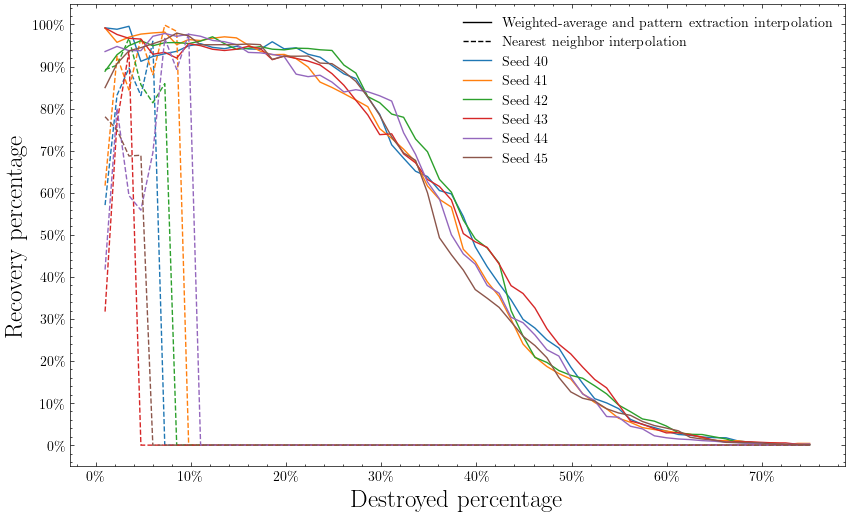

In [28]:
plt.figure(figsize=(10, 6))

percentage_no = 60

percentages = np.linspace(0.01, 0.75, percentage_no)

plt.plot([], [], label='Weighted-average and pattern extraction interpolation', color='black', lw=1)
plt.plot([], [], '--', label='Nearest neighbor interpolation', color='black', lw=1)


for seed in range(40, 46):  # Seeds 40 to 45
    recovered_percentages_new = []
    recovered_percentages_simple = []

    for destroyed_percentage in percentages:
        destroyed_data, coordinates_to_destroy, indices_to_destroy = random_holes(data, destroyed_percentage, seed=seed)
        dead_pixels = find_dead_pixels(destroyed_data, 1.3)
        
        # New interpolation method
        interpolated_data_new, confidence = interpolate_dead_pixels(destroyed_data, 1.3, 0.5, 3, 5)
        recovered_percentage_new = percentage(data, interpolated_data_new)
        recovered_percentages_new.append(recovered_percentage_new)
        
        # Simple interpolation method
        interpolated_data_simple = interpolate_dead_pixels_simple(destroyed_data, 1.5, 3, 100)
        recovered_percentage_simple = percentage(data, interpolated_data_simple)
        recovered_percentages_simple.append(recovered_percentage_simple)

    # Assign a unique color for each seed
    color = plt.cm.tab10(seed % 10)

    # Plot new interpolation method as solid lines
    plt.plot(percentages, recovered_percentages_new, label=f'Seed {seed}', lw=1, color=color)

    # Plot simple interpolation method as dashed lines
    plt.plot(percentages, recovered_percentages_simple, '--', lw=1, color=color)



plt.xlabel('Destroyed percentage', fontsize=18)
plt.xticks(np.arange(0, 0.8, 0.1), [f'{int(p * 100)}'+r'\%' for p in np.arange(0, 0.8, 0.1)])
plt.ylabel('Recovery percentage', fontsize=18)
plt.yticks(np.arange(0, 1.1, 0.1), [f'{int(p * 100)}'+r'\%' for p in np.arange(0, 1.1, 0.1)])
plt.legend()
plt.savefig(f"../Presentations/Introduction Presentation/Pictures/percentages.pdf", bbox_inches='tight', dpi=300)
plt.show()


2025-05-17 13:25:20,311 - stpipe - WARNING - /tmp/ipykernel_9485/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-17 13:25:20,315 - stpipe - WARNING - /tmp/ipykernel_9485/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-17 13:25:20,391 - stpipe - WARNING - /tmp/ipykernel_9485/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)

2025-05-17 13:25:20,392 - stpipe - WARNING - /tmp/ipykernel_9485/2975017886.py:134: RankWarning: Polyfit may be poorly conditioned
  popt_y, pcov_y = np.polyfit(y_points, y_points_vals, 1, cov=True)



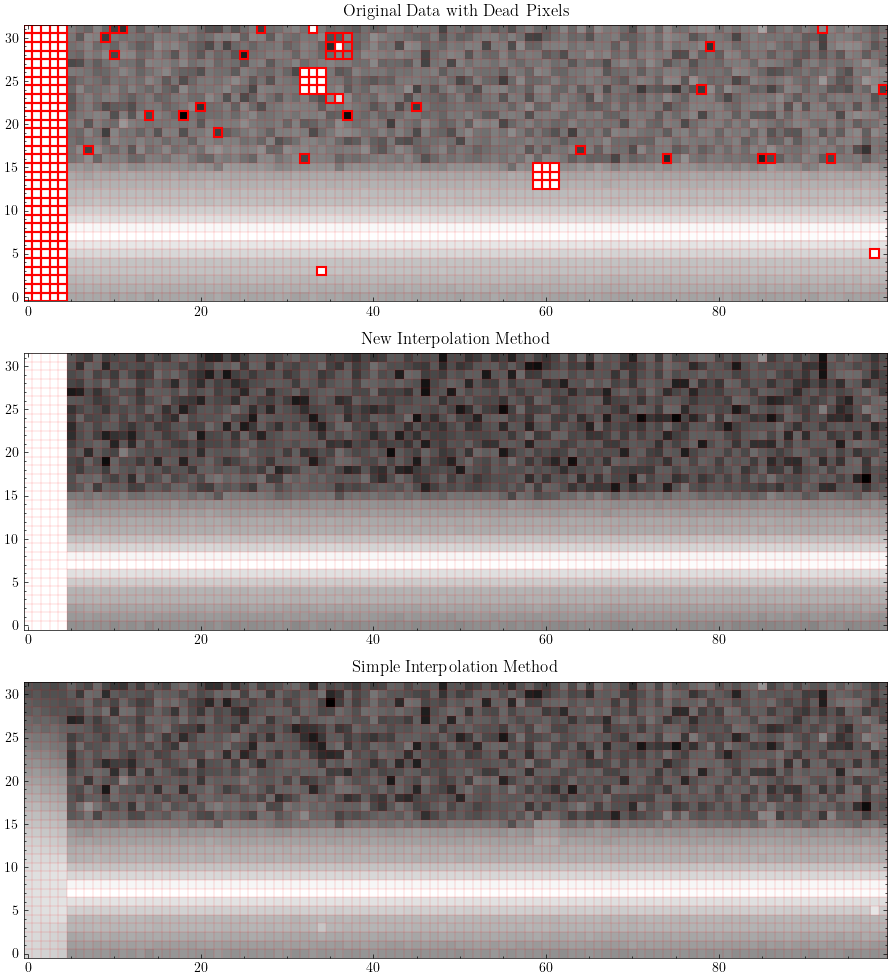

In [ ]:
with fits.open(rateints_files[0]) as hdul:
    data = hdul[1].data
    data = data[50, :, :100]
    dead_pixels = find_dead_pixels(data[:, :], 1.5)
    
    # Interpolate using both methods
    interpolated_new, confidence = interpolate_dead_pixels(data, 1.5, 0.5, 3, 6)
    interpolated_simple = interpolate_dead_pixels_simple(data, 1.5, 3, 4)
    
    # Log-transform the data
    data, interpolated_new, interpolated_simple = (
        np.log10(abs(data)),
        np.log10(abs(interpolated_new)),
        np.log10(abs(interpolated_simple)),
    )

    fig, ax = plt.subplots(3, 1, figsize=(25, 10))
    
    # Original data with dead pixels highlighted
    ax[0].imshow(data[:, :], cmap='grey', aspect='equal', origin='lower')
    for pixel in dead_pixels:
        y, x = pixel  # careful: first index = row (y), second = column (x)
        rect = plt.Rectangle((x - 0.5, y - 0.5), 1, 1, edgecolor='red', facecolor='none', lw=1.5)
        ax[0].add_patch(rect)
    ax[0].set_title("Original Data with Dead Pixels")
    
    # New interpolation method
    ax[1].imshow(interpolated_new[:, :], cmap='grey', aspect='equal', origin='lower')
    ax[1].set_title("New Interpolation Method")
    
    # Simple interpolation method
    ax[2].imshow(interpolated_simple[:, :], cmap='grey', aspect='equal', origin='lower')
    ax[2].set_title("Simple Interpolation Method")
    
    # Add gridlines
    for axis in ax:
        for i in range(data.shape[0]):
            axis.axhline(i + 0.5, color='red', lw=0.1)
        for i in range(data.shape[1]):
            axis.axvline(i + 0.5, color='red', lw=0.1)

    plt.tight_layout()
    plt.show()

In [ ]:
from concurrent.futures import ProcessPoolExecutor

# Save the new FITS files with interpolated data for all files:
for file in rateints_files:
    with fits.open(file) as hdul:
        data = hdul[1].data

        def process_slice(i):
            """Process a single slice of the data."""
            data_temp = data[i, :, :]
            dead_pixels = find_dead_pixels(data_temp, 0.5)
            interpolated = interpolate_dead_pixels(data_temp, 1.5, 0.5, 3, 5)
            return i, interpolated

        # Process slices in parallel using ProcessPoolExecutor
        with ProcessPoolExecutor() as executor:
            results = list(executor.map(process_slice, range(data.shape[0])))

        # Update the data with interpolated slices
        for i, interpolated in results:
            data[i, :, :] = interpolated

        # Save the interpolated data to a new FITS file
        hdul[1].data = data
        hdul.writeto(file.replace('rateints', 'interpolated'), overwrite=True)


In [119]:
# list files in uncal directory
interpolated_files = sorted(glob.glob(det1_dir + '*nrs2_interpolated.fits'))
print(f"Science UNCAL Files:\n{'-'*20}\n" + "\n".join(interpolated_files))


Science UNCAL Files:
--------------------
D:\home\fran\OneDrive\BSc Project\Notebooks\../Data/data_01366/Obs003/stage1\jw01366003001_04101_00001-seg001_nrs2_interpolated.fits
D:\home\fran\OneDrive\BSc Project\Notebooks\../Data/data_01366/Obs003/stage1\jw01366003001_04101_00001-seg002_nrs2_interpolated.fits
D:\home\fran\OneDrive\BSc Project\Notebooks\../Data/data_01366/Obs003/stage1\jw01366003001_04101_00001-seg003_nrs2_interpolated.fits


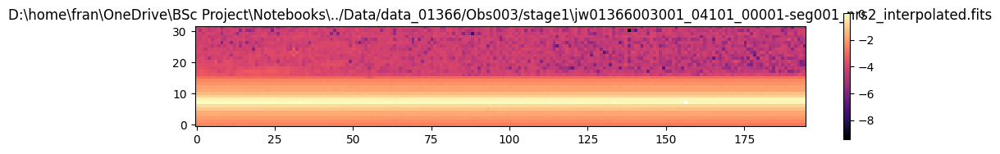

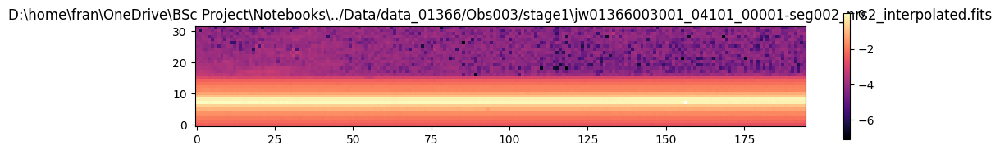

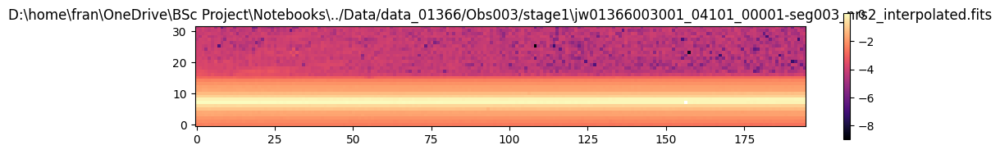

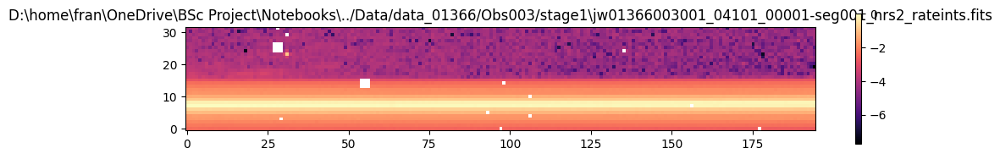

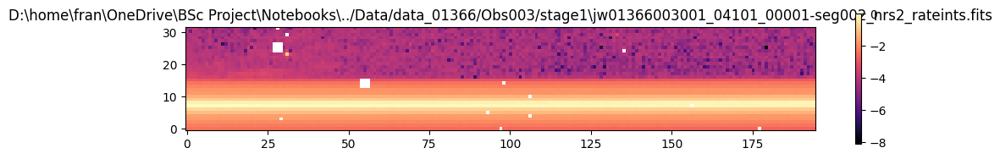

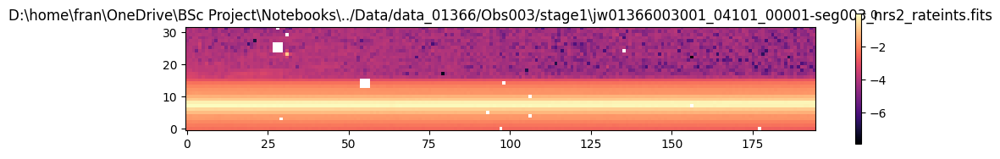

In [120]:
def plot_fits(file):
    with fits.open(file) as hdul:
        data = hdul[1].data
        #data[:, 15:20, 25:30] = np.nan
        #data = np.nansum(data, axis=0)
        data = np.nansum(data, axis=0)
        # Normalize the data
        data = data / np.nanmax(data)
        # take only data where it is smaller than 0.05
        #data = np.log10(abs(data))

        data = np.log10(abs(data))


        plt.figure(figsize=(12, 2))  # Make the figure square
        plt.imshow(data[:, 5:200], cmap='magma', aspect='equal', origin='lower')
        plt.colorbar()
        plt.title(file)
        plt.show()

# Plot each file
for file in interpolated_files:
    plot_fits(file)

for file in rateints_files:
    plot_fits(file)


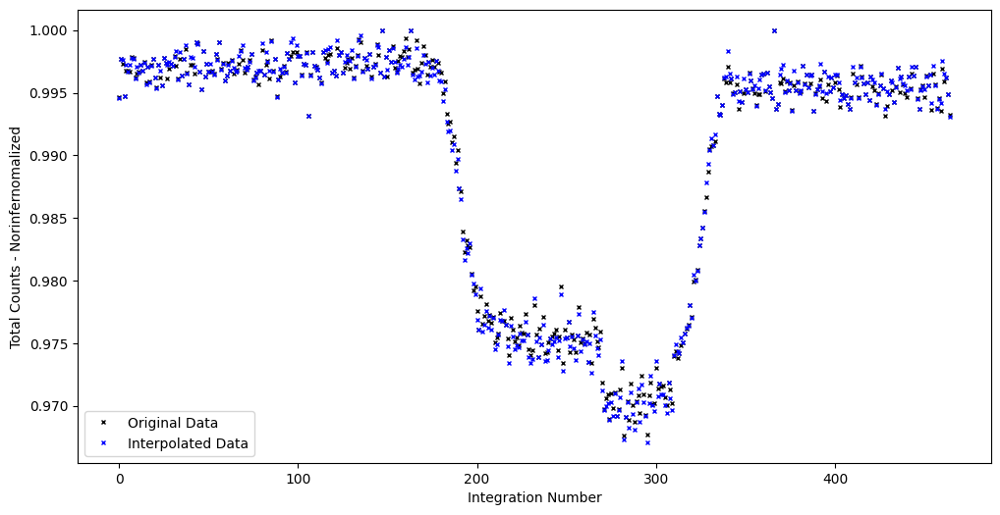

In [136]:
fig, ax = plt.subplots(figsize=(12, 6))

total_data = []
for file in rateints_files:
    with fits.open(file) as hdul:
        data = hdul[1].data
        # slice the data form 10 to 20 on axis 2 and keep axis 1 and 3 untouched
        data = data[:400, 8:11, :]
        data = np.nansum(data, axis=(1, 2)) # Sum over the first two axes
        data = data / np.nanmax(data) # Normalize the data        

        total_data.append(data)
        
total_data = np.concatenate(total_data)
ax.plot(total_data, 'x', ms=3, color='black')
ax.set_xlabel('Integration Number')
ax.set_ylabel('Total Counts - Norinfernomalized')
ax.legend(['Original Data'])

total_data = []
for file in interpolated_files:
    with fits.open(file) as hdul:
        data = hdul[1].data
        # slice the data form 10 to 20 on axis 2 and keep axis 1 and 3 untouched
        data = data[:400, 8:11, :]
        data = np.nansum(data, axis=(1, 2)) # Sum over the first two axes
        data = data / np.nanmax(data) # Normalize the data        
        total_data.append(data)
        
total_data = np.concatenate(total_data)
ax.plot(total_data, 'x', ms=3, color='blue')
ax.set_xlabel('Integration Number')
ax.set_ylabel('Total Counts - Norinfernomalized')
ax.legend(['Original Data', 'Interpolated Data'])

plt.show()